# 🖼️ Deep Art

## 1. Introduction

This is a project which focuses on famous artists and their artwork. It consists of two distinct parts:

1. Creating a Deep learning model for identifying artwork authors
2. Transferring the style of a particular artwork to an image

## 2. Preparation

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image, ImageStat

import torch

from torch import optim

from torch.utils.data import DataLoader

from torchvision import transforms
from torchvision.datasets import ImageFolder
from torchvision.models import vgg19, VGG19_Weights
from torchvision.models.segmentation import deeplabv3_resnet101, DeepLabV3_ResNet101_Weights

import torch.nn as nn
import torch.nn.functional as F

from torchmetrics import Precision, Recall, F1Score

from tqdm import tqdm
from collections import Counter

import os
import shutil
from torch.optim.lr_scheduler import CosineAnnealingLR
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

In [2]:
# Set a manual seed for reproducibility
torch.manual_seed(42)

## 3. Data

We'll use the [Best Artworks Of All Time](https://www.kaggle.com/datasets/ikarus777/best-artworks-of-all-time) dataset from Kaggle. The dataset consists of images of famous artwork, each labeled with the author. We will start by analyzing the data in order to gain a better understanding of it and identify any potential issues.

### 3.1. Load data

In [3]:
dataset_path = "./Best_Artworks_Of_All_Time"
dataset = ImageFolder(dataset_path, transforms.ToTensor())

### 3.2. Metadata

In [4]:
print(f'Number of classes: {len(dataset.classes)}')
print(f'Dataset size: {len(dataset)}')

Number of classes: 50
Dataset size: 8446


### 3.3. Distribution

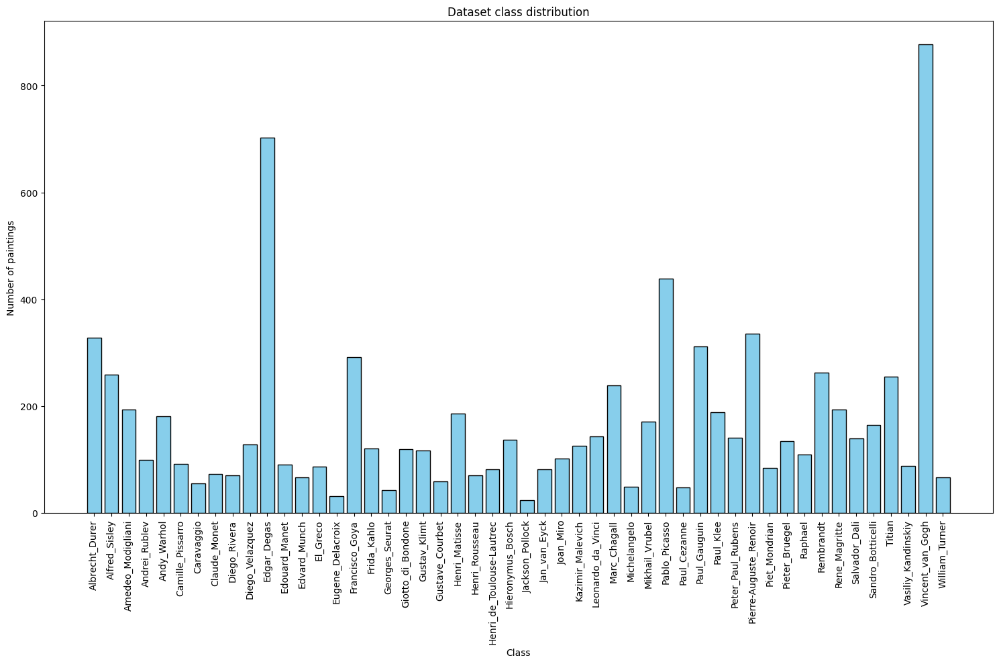

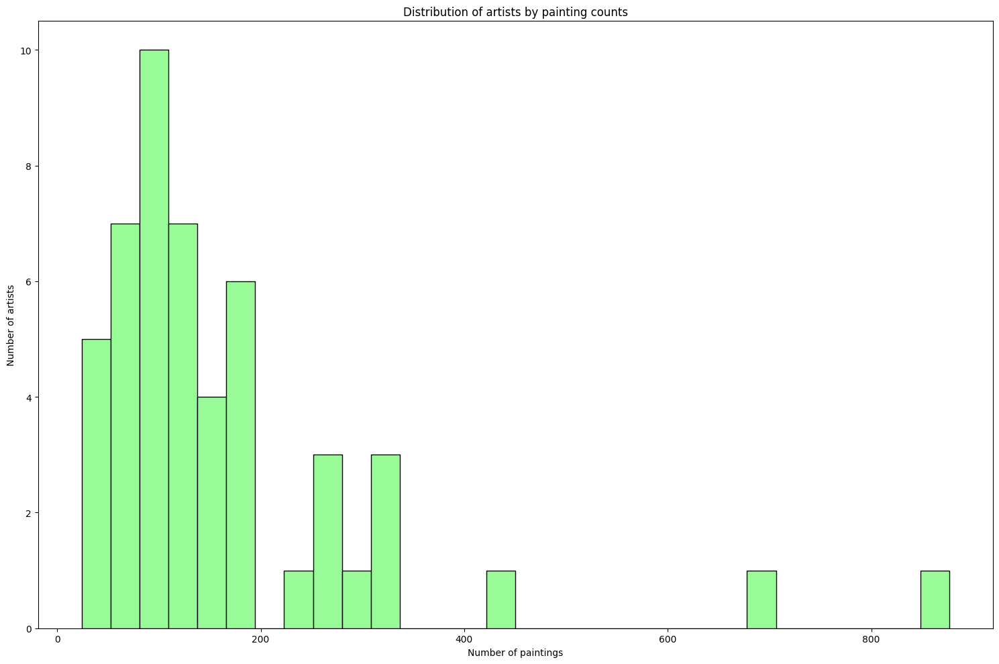

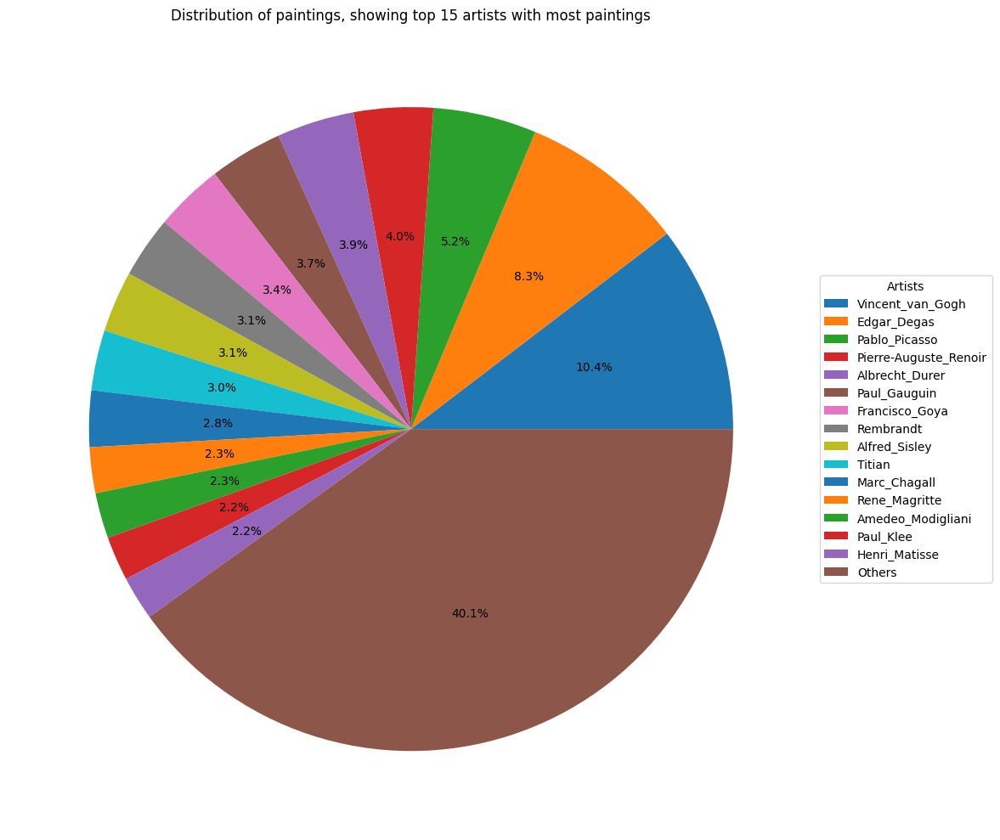

In [6]:
def plot_class_distribution(class_counts):
    class_names = [dataset.classes[i] for i in class_counts.keys()]

    plt.figure(figsize=(15, 10))
    plt.bar(class_names, class_counts.values(), color='skyblue', edgecolor='black')

    plt.xlabel('Class')
    plt.ylabel('Number of paintings')
    plt.title(f'Dataset class distribution')
    plt.xticks(rotation=90)

    plt.tight_layout()
    plt.show()


def plot_artists_count(painting_counts):
    plt.figure(figsize=(15, 10))
    plt.hist(painting_counts, bins=30, color='palegreen', edgecolor='black')

    plt.xlabel('Number of paintings')
    plt.ylabel('Number of artists')
    plt.title(f'Distribution of artists by painting counts')

    plt.tight_layout()
    plt.show()


def plot_top_n_artists(n, class_counts, painting_counts):
    top_artists = Counter(class_counts).most_common(n)
    others_count = sum(painting_counts) - sum([c for _, c in top_artists])

    labels = [dataset.classes[i] for i, _ in top_artists] + ['Others']
    sizes = [count for _, count in top_artists] + [others_count]

    plt.figure(figsize=(15, 10))
    plt.pie(sizes, autopct='%1.1f%%')
    plt.legend(labels,
              title="Artists",
              loc="center left",
              bbox_to_anchor=(1, 0.5))
    plt.title(f'Distribution of paintings, showing top {n} artists with most paintings')
    plt.tight_layout()
    plt.show()


class_counts = Counter(dataset.targets)
sorted_class_counts = dict(sorted(class_counts.items()))

painting_counts = list(class_counts.values())

plot_class_distribution(sorted_class_counts)
plot_artists_count(painting_counts)
plot_top_n_artists(15, class_counts, painting_counts)

As we can see, the dataset is very imbalanced. There are paintings of 50 artists in the dataset, however, most of them have less than 200 paintings available. So, in order to achieve better performance and reduce computation time we'll train the models to recognise paintings only for the top 10 artists with most paintings.

### 3.4. Split the data

We'll split the dataset into train, validation and test subsets.

In [ ]:
def copy_files(indices, dataset, split_name):
    for idx in indices:
        path, class_idx = dataset.samples[idx]
        class_name = dataset.classes[class_idx]
        target_dir = os.path.join(output_root, split_name, class_name)
        os.makedirs(target_dir, exist_ok=True)
        shutil.copy2(path, target_dir)

original_root = './Best_Artworks_Of_All_Time_Top_10'
output_root = './Data'

splits = {'train': 0.6, 'val': 0.2, 'test': 0.2}

for split in splits:
    os.makedirs(os.path.join(output_root, split), exist_ok=True)

dataset = ImageFolder(root=original_root, transform=None)
total = len(dataset)
indices = list(range(total))
torch.manual_seed(42)
torch.random.manual_seed(42)
indices = torch.randperm(total).tolist()

n_train = int(splits['train'] * total)
n_val = int(splits['val'] * total)
train_idx = indices[:n_train]
val_idx = indices[n_train:n_train + n_val]
test_idx = indices[n_train + n_val:]

copy_files(train_idx, dataset, 'train')
copy_files(val_idx, dataset, 'val')
copy_files(test_idx, dataset, 'test')


### 3.5. Load the datasets

In [7]:
dataset_path = "./Data"
image_transforms = transforms.Compose([transforms.ToTensor()])

datasets = {}
for name in ["train", "val", "test"]:
    datasets[name] = ImageFolder(dataset_path + "/" + name, image_transforms)
    print(f'{name.capitalize()} dataset size: {len(datasets[name])}')

Train dataset size: 2436
Val dataset size: 812
Test dataset size: 812


### 3.6. Sample data

In [8]:
def show_axis_raw_image(ax, image, title):
    ax.imshow(image)
    ax.set_title(title)
    ax.axis('off')

def show_axis_image(ax, image, title, axis='off'):
    image = image.squeeze().permute(1, 2, 0)

    ax.imshow(image)
    ax.set_title(title)
    ax.axis(axis)


def show_image(image, title):
    image = image.squeeze().permute(1, 2, 0)

    plt.imshow(image)
    plt.suptitle(title)
    plt.axis('off')

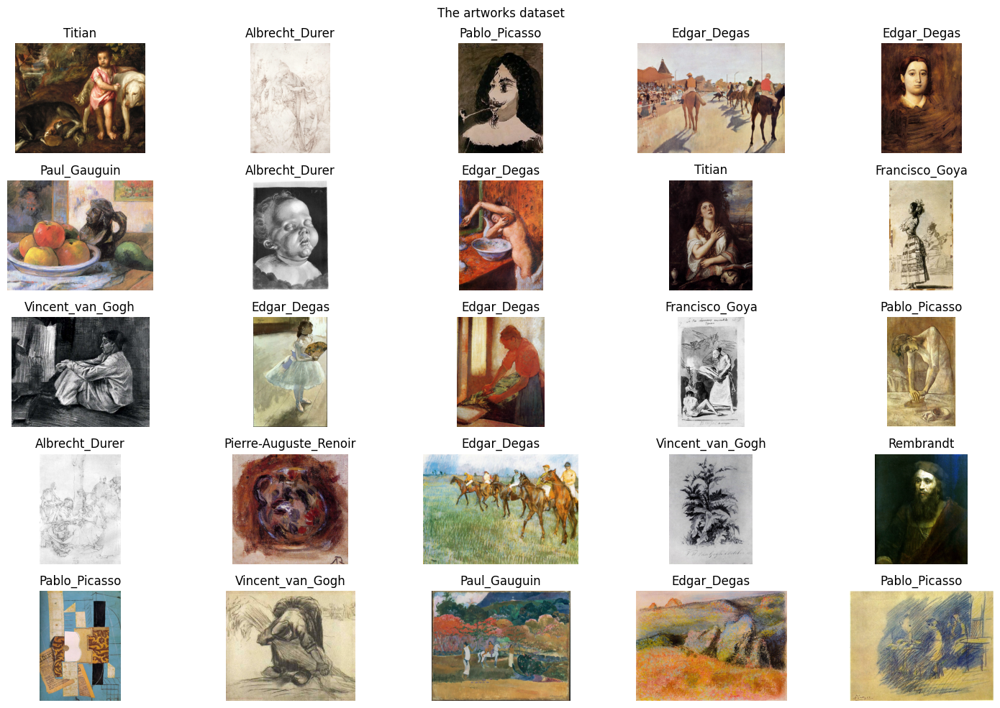

In [12]:
def plot_images(dataloader):
    iterator = iter(dataloader)

    _, axs = plt.subplots(5, 5, figsize=(15, 10))
    for ax in axs.flat:
        image, label = next(iterator)
        label = dataloader.dataset.classes[label]

        show_axis_image(ax, image, label)

    plt.suptitle("The artworks dataset")
    plt.tight_layout()
    plt.show()


dataloader = DataLoader(datasets['train'], shuffle=True)
plot_images(dataloader)

We can see that the dataset contains images of various sizes. Also there are paintings of different types and genres - portraits, nature, abstract paintings, black and white, etc.

### 3.7. Image sizes

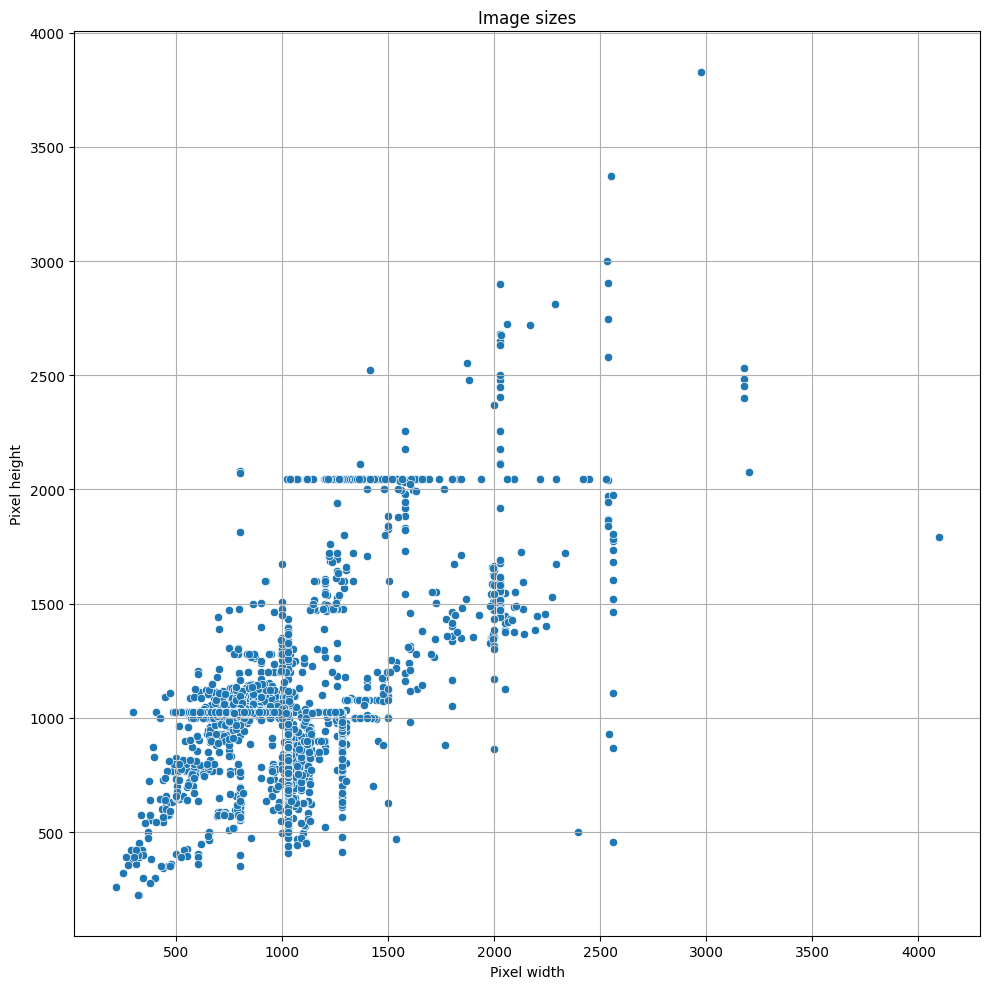

In [16]:
def get_image_sizes(dataset):
    image_sizes = []
    for path, _ in dataset.samples:
        with Image.open(path) as img:
            width, height = img.size
            image_sizes.append({'width': width, 'height': height})

    return image_sizes

train_image_sizes = get_image_sizes(datasets['train'])
df = pd.DataFrame(train_image_sizes)

plt.figure(figsize=(10, 10))
sns.scatterplot(data=df,
                x='width',
                y='height')

plt.title('Image sizes')
plt.xlabel('Pixel width')
plt.ylabel('Pixel height')

plt.grid(True)
plt.tight_layout()
plt.show()


### 3.8. Image brightness

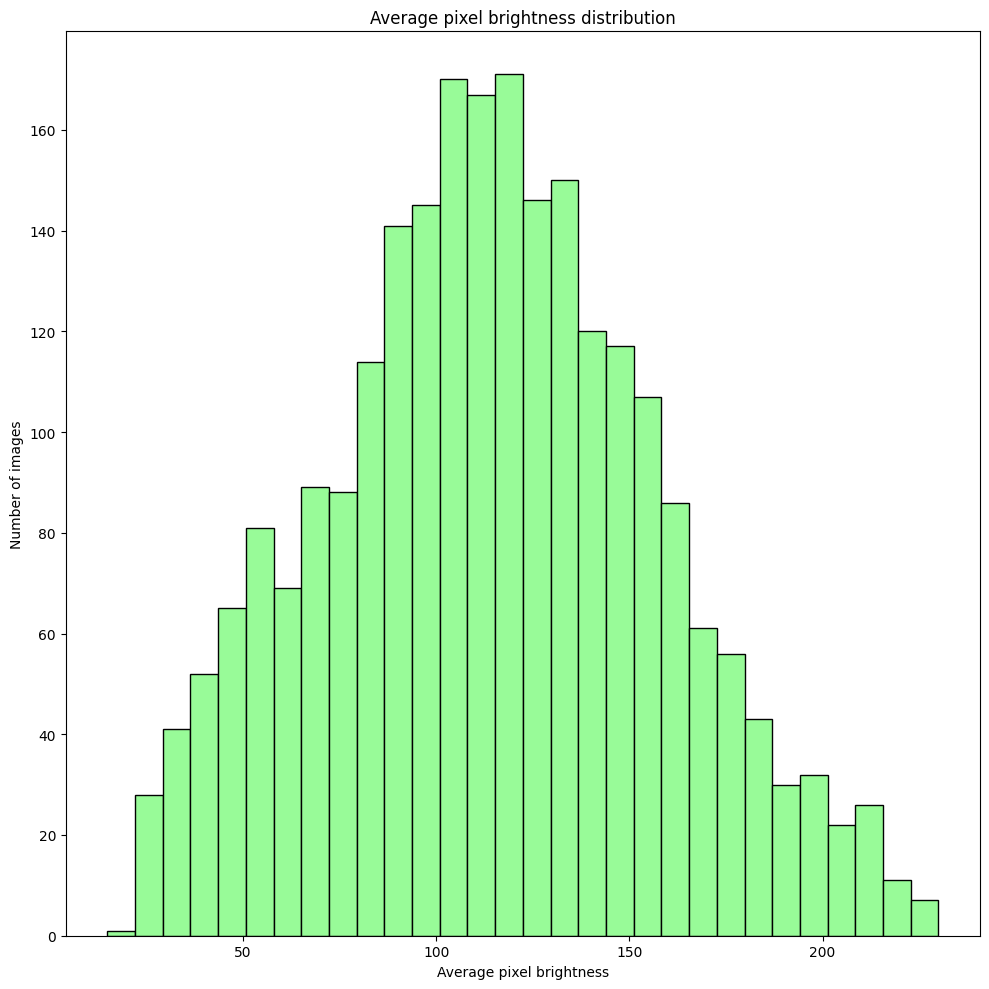

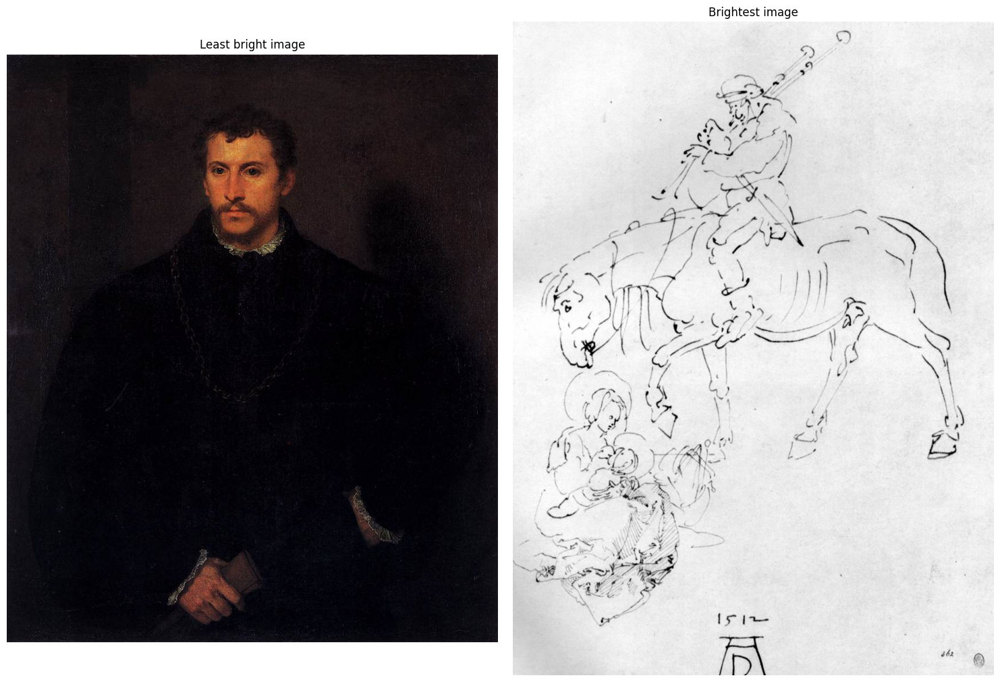

In [17]:
# https://stackoverflow.com/questions/3490727/what-are-some-methods-to-analyze-image-brightness-using-python

def get_image_brightness(dataset):
    image_brightnesses = {}
    for path, _ in dataset.samples:
        with Image.open(path) as img:
            img_gray = img.convert('L')
            stat = ImageStat.Stat(img_gray)
            image_brightnesses[path] = stat.mean[0]

    return image_brightnesses

train_image_brigtnesses = get_image_brightness(datasets['train'])

plt.figure(figsize=(10, 10))
plt.hist(train_image_brigtnesses.values(),
         bins=30,
         color='palegreen',
         edgecolor='black')

plt.title('Average pixel brightness distribution')
plt.xlabel('Average pixel brightness')
plt.ylabel('Number of images')

plt.tight_layout()
plt.show()

least_bright_image = min(train_image_brigtnesses,
                         key=train_image_brigtnesses.get)
brightest_image = max(train_image_brigtnesses, key=train_image_brigtnesses.get)

_, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 10))

least_bright_image = Image.open(least_bright_image)
brightest_image = Image.open(brightest_image)

show_axis_raw_image(ax1, least_bright_image, "Least bright image")
show_axis_raw_image(ax2, brightest_image, "Brightest image")

plt.tight_layout()
plt.show()


## 4. Artwork author classification

First, let's tackle the author classification task. We'll build a custom ResNet18, train a baseline model and improve it iteratively.

In [22]:
class ResidualBlock(nn.Module):

    def __init__(self, in_channels, out_channels):
        super().__init__()

        stride = 2 if in_channels != out_channels else 1

        self.conv1 = nn.Sequential(
            nn.Conv2d(in_channels,
                      out_channels,
                      kernel_size=3,
                      stride=stride,
                      padding=1,
                      bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(),
        )

        self.conv2 = nn.Sequential(
            nn.Conv2d(out_channels,
                      out_channels,
                      kernel_size=3,
                      padding=1,
                      bias=False),
            nn.BatchNorm2d(out_channels),
        )

        self.downsample = nn.Sequential(
            nn.Conv2d(in_channels,
                      out_channels,
                      kernel_size=3,
                      stride=stride,
                      padding=1,
                      bias=False),
            nn.BatchNorm2d(out_channels),
        ) if in_channels != out_channels else None

        self.relu = nn.ReLU()

    def forward(self, x):
        residual = self.downsample(x) if self.downsample else x

        x = self.conv1(x)
        x = self.conv2(x)
        x += residual
        x = self.relu(x)

        return x

In [23]:
class ResNet(nn.Module):

    def __init__(self):
        super().__init__()

        self.conv1 = nn.Sequential(
            nn.Conv2d(3,
                      64,
                      kernel_size=7,
                      stride=2,
                      padding=3,
                      bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(),
        )

        self.max_pool = nn.MaxPool2d(kernel_size=3, stride=2, padding=1)

        self.block1 = nn.Sequential(
            ResidualBlock(64, 64),
            ResidualBlock(64, 64)
        )

        self.block2 = nn.Sequential(
            ResidualBlock(64, 128),
            ResidualBlock(128, 128)
        )

        self.block3 = nn.Sequential(
            ResidualBlock(128, 256),
            ResidualBlock(256, 256)
        )

        self.block4 = nn.Sequential(
            ResidualBlock(256, 512),
            ResidualBlock(512, 512)
        )

        self.avg_pool = nn.AvgPool2d(kernel_size=7, stride=1)
        self.flatten = nn.Flatten()
        self.fc1 = nn.Linear(512, 10)

    def forward(self, x):
        x = self.conv1(x)
        x = self.max_pool(x)
        x = self.block1(x)
        x = self.block2(x)
        x = self.block3(x)
        x = self.block4(x)
        x = self.avg_pool(x)
        x = self.flatten(x)
        x = self.fc1(x)

        return x

### 4.1. Training a custom ResNet18

Now we'll define the main training and validation loops.

In [24]:
def create_dataloader(filename, transforms, batch_size, shuffle):
    dataset = ImageFolder(filename, transforms)

    should_drop_last = len(dataset) % batch_size != 0
    if should_drop_last:
        print(f"Will drop incomplete last batch for dataset {filename}")

    return DataLoader(dataset,
                      shuffle=shuffle,
                      batch_size=batch_size,
                      drop_last=should_drop_last)

In [26]:
def train(dataloader_train,
          dataloader_validate,
          optimizer,
          net,
          epochs,
          filename,
          weights=None,
          scheduler=None,
          save_best=False):
    if weights is not None:
        criterion = nn.CrossEntropyLoss(weight=weights)
    else:
        criterion = nn.CrossEntropyLoss()

    avg_training_losses = []
    training_metrics = []

    avg_validation_losses = []
    validation_metrics = []

    best_validation_metric = 0.0

    for epoch in range(epochs):
        print(f"Epoch [{epoch+1}/{epochs}]:")
        avg_training_loss, training_metric = epoch_train(
            dataloader_train, net, optimizer, criterion)

        avg_training_losses.append(avg_training_loss)
        training_metrics.append(training_metric)

        avg_validation_loss, validation_metric = epoch_eval(
            dataloader_validate, net, criterion)

        avg_validation_losses.append(avg_validation_loss)
        validation_metrics.append(validation_metric)

        if scheduler is not None:
            scheduler.step()

        print(f'''Average training loss: {avg_training_loss}
Average validation loss: {avg_validation_loss}
Training metric score: {training_metric}
Validation metric score: {validation_metric}
''')

        if save_best and validation_metric > best_validation_metric:
            print(
                f"New best model found (F1: {validation_metric:.4f}), saving..."
            )
            best_validation_metric = validation_metric
            torch.save(net.state_dict(), filename)

    if not save_best:
        torch.save(net.state_dict(), filename)

    return avg_training_losses, avg_validation_losses, training_metrics, validation_metrics


def epoch_train(dataloader_train, net, optimizer, criterion):
    net.train()

    training_metric = F1Score(task='multiclass',
                              num_classes=10,
                              average='micro')

    total_loss = 0.0
    for inputs, targets in tqdm(dataloader_train):
        optimizer.zero_grad()

        outputs = net(inputs)
        loss = criterion(outputs, targets)
        total_loss += loss.item()

        training_metric.update(outputs, targets)

        loss.backward()
        optimizer.step()

    return total_loss / len(dataloader_train), training_metric.compute().item()


def epoch_eval(dataloader_validate, net, criterion):
    net.eval()

    validation_metric = F1Score(task='multiclass',
                                num_classes=10,
                                average='micro')

    total_loss = 0.0
    with torch.no_grad():
        for inputs, targets in tqdm(dataloader_validate):
            outputs = net(inputs)
            loss = criterion(outputs, targets)
            total_loss += loss.item()

            validation_metric.update(outputs, targets)

    return total_loss / len(dataloader_validate), validation_metric.compute(
    ).item()


def plot(avg_training_losses, avg_validation_losses, training_metric,
         validation_metric):
    _, (ax1, ax2) = plt.subplots(1, 2)

    ax1.set_title("Model loss")
    ax1.set_xlabel("Epoch")
    ax1.set_ylabel("Loss")

    x = range(len(avg_training_losses))

    ax1.plot(x, avg_training_losses, label='Training loss')
    ax1.plot(x, avg_validation_losses, label='Validation loss')

    ax1.legend()

    ax2.set_title("Model performance")
    ax2.set_xlabel("Epoch")
    ax2.set_ylabel("Metric")

    x = range(len(training_metric))

    ax2.plot(x, training_metric, label='Training metric')
    ax2.plot(x, validation_metric, label='Validation metric')

    ax2.legend()

    plt.tight_layout()
    plt.show()


def train_model(net, optimizer, train_transforms, validation_transforms,
                batch_size, epochs, filename, weights=None, scheduler=None, save_best=False):
    dataloader_train = create_dataloader(dataset_path + '/train', train_transforms,
                                         batch_size, True)
    dataloader_validate = create_dataloader(dataset_path + '/val', validation_transforms,
                                            batch_size, False)

    avg_training_losses, avg_validation_losses, training_metrics, validation_metrics = train(
        dataloader_train, dataloader_validate, optimizer, net, epochs, filename, weights,
        scheduler, save_best)

    plot(avg_training_losses, avg_validation_losses, training_metrics,
         validation_metrics)

In [27]:
def test(net, dataloader):
    net.eval()

    global_micro_precision = Precision(task='multiclass',
                                       num_classes=10,
                                       average='micro')
    global_micro_recall = Recall(task='multiclass',
                                 num_classes=10,
                                 average='micro')
    global_micro_f1 = F1Score(task='multiclass',
                              num_classes=10,
                              average='micro')
    per_class_f1 = F1Score(task='multiclass', num_classes=10, average='none')

    all_preds = []
    all_targets = []

    with torch.no_grad():
        for inputs, targets in tqdm(dataloader):
            outputs = net(inputs)

            _, preds = torch.max(outputs, 1)

            all_preds.extend(preds.numpy())
            all_targets.extend(targets.numpy())

            global_micro_precision.update(outputs, targets)
            global_micro_recall.update(outputs, targets)
            global_micro_f1.update(outputs, targets)
            per_class_f1.update(outputs, targets)

    return global_micro_precision.compute().item(
    ), global_micro_recall.compute().item(), global_micro_f1.compute().item(
    ), per_class_f1.compute(), all_preds, all_targets


def get_per_class_f1(per_class_f1, class_to_idx):
    per_class_f1_values = {
        class_name: round(per_class_f1[idx].item(), 2)
        for class_name, idx in class_to_idx.items()
    }

    return pd.DataFrame({
        'Metric value': per_class_f1_values.values(),
    },
                        index=per_class_f1_values.keys())


def test_model(net, test_transforms, batch_size, dataset='val'):
    dataloader_test = create_dataloader(dataset_path + "/" + dataset,
                                        test_transforms, batch_size, False)

    global_micro_precision, global_micro_recall, global_micro_f1, per_class_f1, all_preds, all_targets = test(
        net, dataloader_test)

    print(f'''
Summary statistics:
Precision: {global_micro_precision}
Recall: {global_micro_recall}
F1: {global_micro_f1}''')

    per_class_f1_values = get_per_class_f1(
        per_class_f1, dataloader_test.dataset.class_to_idx)

    print("Per class F1 score:")
    print(per_class_f1_values)

    per_class_f1_values.plot(kind='bar',
                             xlabel='Class',
                             ylabel='F1 score',
                             title=f'Per class F1 score')

    return all_preds, all_targets

Let's set initial values for the hyperparameters and start with the experiments.

In [29]:
batch_size = 32
image_size = 224
epochs = 20
lr = 0.001

image_transforms = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize((image_size, image_size)),
    transforms.Normalize(
        mean=[0.485, 0.456, 0.406],
        std=[0.229, 0.224, 0.225]
    )
])

Will drop incomplete last batch for dataset ./Data/train
Will drop incomplete last batch for dataset ./Data/val
Epoch [1/20]:


100%|██████████| 25/25 [00:37<00:00,  1.51s/it]


Average training loss: 1.8720698058605194
Average validation loss: 1.6791494965553284
Training metric score: 0.35320723056793213
Validation metric score: 0.36375001072883606

Epoch [2/20]:


100%|██████████| 25/25 [00:40<00:00,  1.61s/it]


Average training loss: 1.6670545433696948
Average validation loss: 1.5861672949790955
Training metric score: 0.4021381437778473
Validation metric score: 0.45875000953674316

Epoch [3/20]:


100%|██████████| 25/25 [00:41<00:00,  1.64s/it]


Average training loss: 1.551262240660818
Average validation loss: 1.6364495861530304
Training metric score: 0.453125
Validation metric score: 0.4350000023841858

Epoch [4/20]:


100%|██████████| 25/25 [00:40<00:00,  1.62s/it]


Average training loss: 1.511187233422932
Average validation loss: 1.6762676060199737
Training metric score: 0.46792763471603394
Validation metric score: 0.42875000834465027

Epoch [5/20]:


100%|██████████| 25/25 [00:40<00:00,  1.61s/it]


Average training loss: 1.4481101145869808
Average validation loss: 1.4758423519134523
Training metric score: 0.4975329041481018
Validation metric score: 0.512499988079071

Epoch [6/20]:


100%|██████████| 25/25 [00:42<00:00,  1.70s/it]


Average training loss: 1.3971357024029682
Average validation loss: 1.4169882106781007
Training metric score: 0.5024670958518982
Validation metric score: 0.5287500023841858

Epoch [7/20]:


100%|██████████| 25/25 [00:46<00:00,  1.85s/it]


Average training loss: 1.3370440249380313
Average validation loss: 1.412106761932373
Training metric score: 0.5337170958518982
Validation metric score: 0.5087500214576721

Epoch [8/20]:


100%|██████████| 25/25 [00:46<00:00,  1.87s/it]


Average training loss: 1.3336172111724551
Average validation loss: 1.35994149684906
Training metric score: 0.5333059430122375
Validation metric score: 0.543749988079071

Epoch [9/20]:


100%|██████████| 25/25 [00:48<00:00,  1.95s/it]


Average training loss: 1.2505846980370974
Average validation loss: 1.3068663096427917
Training metric score: 0.5699012875556946
Validation metric score: 0.5537499785423279

Epoch [10/20]:


100%|██████████| 25/25 [00:48<00:00,  1.93s/it]


Average training loss: 1.2133638341175883
Average validation loss: 1.2960454154014587
Training metric score: 0.5785362124443054
Validation metric score: 0.5625

Epoch [11/20]:


100%|██████████| 25/25 [00:49<00:00,  1.97s/it]


Average training loss: 1.1865453822048087
Average validation loss: 1.457129956483841
Training metric score: 0.6036184430122375
Validation metric score: 0.5462499856948853

Epoch [12/20]:


100%|██████████| 25/25 [00:51<00:00,  2.08s/it]


Average training loss: 1.1430656690346568
Average validation loss: 1.360518822669983
Training metric score: 0.5896381735801697
Validation metric score: 0.5212500095367432

Epoch [13/20]:


100%|██████████| 25/25 [00:48<00:00,  1.93s/it]


Average training loss: 1.146012888142937
Average validation loss: 1.6757802790403367
Training metric score: 0.6052631735801697
Validation metric score: 0.44749999046325684

Epoch [14/20]:


100%|██████████| 25/25 [00:48<00:00,  1.94s/it]


Average training loss: 1.092690955651434
Average validation loss: 1.3345986354351043
Training metric score: 0.6254112124443054
Validation metric score: 0.53125

Epoch [15/20]:


100%|██████████| 25/25 [00:48<00:00,  1.96s/it]


Average training loss: 1.0102807157918026
Average validation loss: 1.265078296661377
Training metric score: 0.6525493264198303
Validation metric score: 0.5950000286102295

Epoch [16/20]:


100%|██████████| 25/25 [00:49<00:00,  1.97s/it]


Average training loss: 0.9808859331043143
Average validation loss: 1.270571495294571
Training metric score: 0.6628289222717285
Validation metric score: 0.5899999737739563

Epoch [17/20]:


100%|██████████| 25/25 [00:49<00:00,  1.98s/it]


Average training loss: 0.9212986568087026
Average validation loss: 1.2160104608535767
Training metric score: 0.6817434430122375
Validation metric score: 0.5699999928474426

Epoch [18/20]:


100%|██████████| 25/25 [00:49<00:00,  2.00s/it]


Average training loss: 0.894293703530964
Average validation loss: 1.3500551998615264
Training metric score: 0.6866776347160339
Validation metric score: 0.5874999761581421

Epoch [19/20]:


100%|██████████| 25/25 [00:49<00:00,  1.99s/it]


Average training loss: 0.878680125663155
Average validation loss: 1.2635045862197876
Training metric score: 0.6916118264198303
Validation metric score: 0.5674999952316284

Epoch [20/20]:


100%|██████████| 25/25 [00:53<00:00,  2.14s/it]


Average training loss: 0.8377937600016594
Average validation loss: 1.1474687814712525
Training metric score: 0.7129934430122375
Validation metric score: 0.6162499785423279



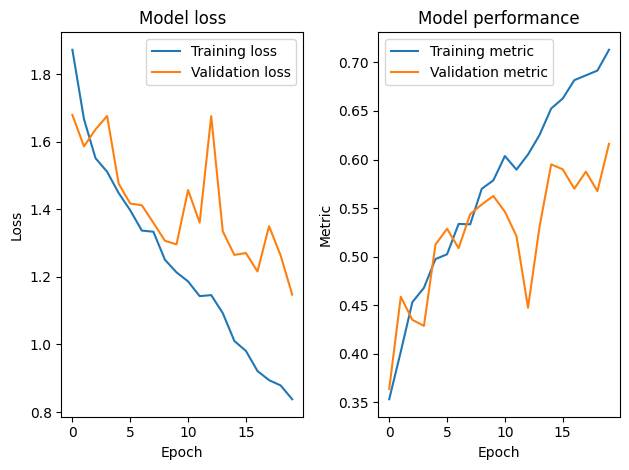

Will drop incomplete last batch for dataset ./Data/val


100%|██████████| 25/25 [00:53<00:00,  2.15s/it]


Summary statistics:
Precision: 0.6162499785423279
Recall: 0.6162499785423279
F1: 0.6162499785423279
Per class F1 score:
                       Metric value
Albrecht_Durer                 0.79
Alfred_Sisley                  0.80
Edgar_Degas                    0.65
Francisco_Goya                 0.46
Pablo_Picasso                  0.56
Paul_Gauguin                   0.60
Pierre-Auguste_Renoir          0.46
Rembrandt                      0.74
Titian                         0.46
Vincent_van_Gogh               0.62


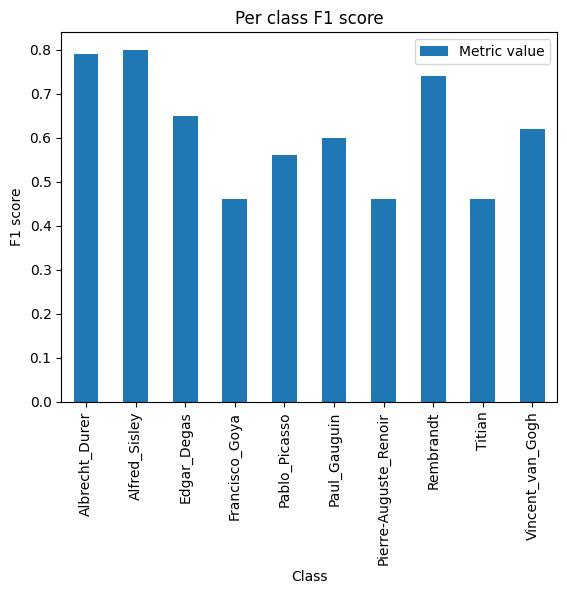

In [ ]:
resnet = ResNet()
optimizer = optim.AdamW(resnet.parameters(), lr)

train_model(resnet, optimizer, image_transforms, image_transforms, batch_size, epochs, "models/resnet_1.pt")
test_model(resnet, image_transforms, batch_size)

The baseline model achieved a 0.61 overall F1 score, however the per-class F1 scores reflect the fact that the dataset is imbalanced. So, let's try adding class weights to the loss function and see whether this improves the performance.

In [30]:
labels = datasets["train"].targets
class_counts = list(Counter(labels).values())
class_weights = 1.0 / np.array(class_counts)
class_weights_tensor = torch.FloatTensor(class_weights)

Will drop incomplete last batch for dataset ./Data/train
Will drop incomplete last batch for dataset ./Data/val
Epoch [1/20]:


100%|██████████| 25/25 [00:37<00:00,  1.50s/it]


Average training loss: 1.9083121450323808
Average validation loss: 1.9474969983100892
Training metric score: 0.28166118264198303
Validation metric score: 0.3487499952316284

Epoch [2/20]:


100%|██████████| 25/25 [00:40<00:00,  1.62s/it]


Average training loss: 1.7116607380540747
Average validation loss: 1.8644502639770508
Training metric score: 0.34827303886413574
Validation metric score: 0.36375001072883606

Epoch [3/20]:


100%|██████████| 25/25 [00:40<00:00,  1.63s/it]


Average training loss: 1.6250463237887935
Average validation loss: 1.6655014610290528
Training metric score: 0.3877467215061188
Validation metric score: 0.36625000834465027

Epoch [4/20]:


100%|██████████| 25/25 [00:41<00:00,  1.68s/it]


Average training loss: 1.568594206320612
Average validation loss: 1.8784954571723937
Training metric score: 0.40666118264198303
Validation metric score: 0.3425000011920929

Epoch [5/20]:


100%|██████████| 25/25 [00:44<00:00,  1.77s/it]


Average training loss: 1.5073285244013135
Average validation loss: 1.7164338898658753
Training metric score: 0.41981908679008484
Validation metric score: 0.4000000059604645

Epoch [6/20]:


100%|██████████| 25/25 [00:44<00:00,  1.80s/it]


Average training loss: 1.4810093625595695
Average validation loss: 1.6734099769592286
Training metric score: 0.43174341320991516
Validation metric score: 0.39250001311302185

Epoch [7/20]:


100%|██████████| 25/25 [00:45<00:00,  1.82s/it]


Average training loss: 1.3978533313462609
Average validation loss: 1.841014837026596
Training metric score: 0.4728618562221527
Validation metric score: 0.39625000953674316

Epoch [8/20]:


100%|██████████| 25/25 [00:44<00:00,  1.79s/it]


Average training loss: 1.371944953736506
Average validation loss: 1.6188828253746033
Training metric score: 0.4753289520740509
Validation metric score: 0.4312500059604645

Epoch [9/20]:


100%|██████████| 25/25 [00:46<00:00,  1.85s/it]


Average training loss: 1.3319994140612452
Average validation loss: 1.6392654848098756
Training metric score: 0.5024670958518982
Validation metric score: 0.41624999046325684

Epoch [10/20]:


100%|██████████| 25/25 [00:45<00:00,  1.84s/it]


Average training loss: 1.320647648290584
Average validation loss: 1.8453830480575562
Training metric score: 0.5008223652839661
Validation metric score: 0.4074999988079071

Epoch [11/20]:


100%|██████████| 25/25 [00:45<00:00,  1.84s/it]


Average training loss: 1.2810140197214328
Average validation loss: 1.409408243894577
Training metric score: 0.5069901347160339
Validation metric score: 0.5

Epoch [12/20]:


100%|██████████| 25/25 [00:45<00:00,  1.81s/it]


Average training loss: 1.2552311828261928
Average validation loss: 1.4331615710258483
Training metric score: 0.5337170958518982
Validation metric score: 0.5174999833106995

Epoch [13/20]:


100%|██████████| 25/25 [00:45<00:00,  1.81s/it]


Average training loss: 1.2486369335337688
Average validation loss: 1.4798336005210877
Training metric score: 0.5222039222717285
Validation metric score: 0.48249998688697815

Epoch [14/20]:


100%|██████████| 25/25 [00:44<00:00,  1.78s/it]


Average training loss: 1.1973959395759983
Average validation loss: 1.3500015550851823
Training metric score: 0.5431743264198303
Validation metric score: 0.5174999833106995

Epoch [15/20]:


100%|██████████| 25/25 [00:48<00:00,  1.94s/it]


Average training loss: 1.15146430777876
Average validation loss: 1.726683348417282
Training metric score: 0.5534539222717285
Validation metric score: 0.4350000023841858

Epoch [16/20]:


100%|██████████| 25/25 [00:47<00:00,  1.90s/it]


Average training loss: 1.1202661904849505
Average validation loss: 1.340338191986084
Training metric score: 0.5834704041481018
Validation metric score: 0.5062500238418579

Epoch [17/20]:


100%|██████████| 25/25 [00:47<00:00,  1.90s/it]


Average training loss: 1.0850089051221545
Average validation loss: 1.5965186059474945
Training metric score: 0.5777137875556946
Validation metric score: 0.4737499952316284

Epoch [18/20]:


100%|██████████| 25/25 [00:46<00:00,  1.87s/it]


Average training loss: 1.0757108597378982
Average validation loss: 1.8872626876831056
Training metric score: 0.5810033082962036
Validation metric score: 0.39500001072883606

Epoch [19/20]:


100%|██████████| 25/25 [00:47<00:00,  1.91s/it]


Average training loss: 1.0315071861994893
Average validation loss: 1.255878323316574
Training metric score: 0.6233552694320679
Validation metric score: 0.5924999713897705

Epoch [20/20]:


100%|██████████| 25/25 [00:46<00:00,  1.86s/it]

Average training loss: 1.0024202379741167
Average validation loss: 1.3761782586574554
Training metric score: 0.6110197305679321
Validation metric score: 0.5362499952316284



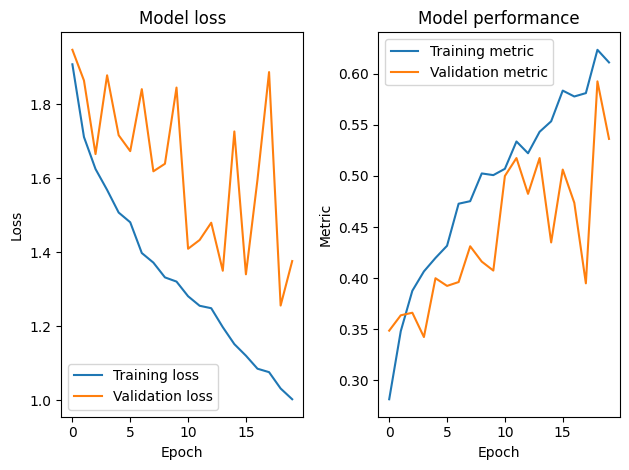

Will drop incomplete last batch for dataset ./Data/val


100%|██████████| 25/25 [00:52<00:00,  2.08s/it]



Summary statistics:
Precision: 0.5362499952316284
Recall: 0.5362499952316284
F1: 0.5362499952316284
Per class F1 score:
                       Metric value
Albrecht_Durer                 0.78
Alfred_Sisley                  0.72
Edgar_Degas                    0.64
Francisco_Goya                 0.54
Pablo_Picasso                  0.40
Paul_Gauguin                   0.64
Pierre-Auguste_Renoir          0.38
Rembrandt                      0.63
Titian                         0.22
Vincent_van_Gogh               0.35


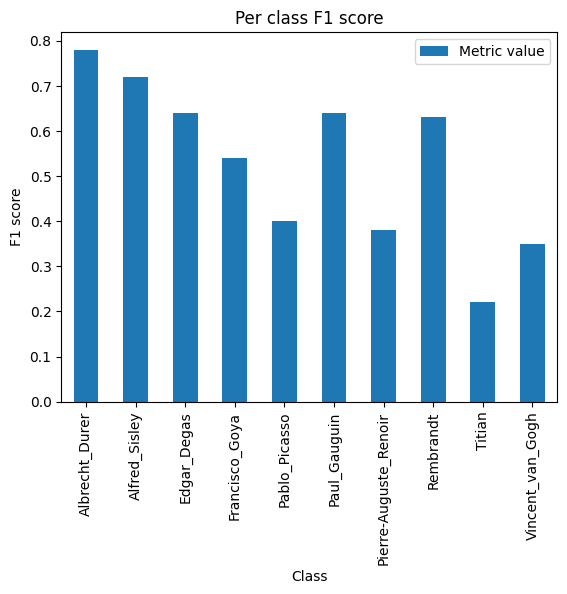

In [ ]:
resnet_2 = ResNet()
optimizer = optim.AdamW(resnet_2.parameters(), lr)

train_model(resnet_2, optimizer, image_transforms, image_transforms,
            batch_size, epochs, "models/resnet_2.pt", class_weights_tensor)
test_model(resnet_2, image_transforms, batch_size)

Unfortunately, the class weights lead to worse performance both overall and for each class. Another observation that can be made for both models is that they start to overfit. So, let's try adding some weight decay.

Will drop incomplete last batch for dataset ./Data/train
Will drop incomplete last batch for dataset ./Data/val
Epoch [1/20]:


100%|██████████| 25/25 [00:46<00:00,  1.84s/it]


Average training loss: 2.401938242347617
Average validation loss: 2.5526157307624815
Training metric score: 0.2006578892469406
Validation metric score: 0.19499999284744263

Epoch [2/20]:


100%|██████████| 25/25 [00:47<00:00,  1.89s/it]


Average training loss: 1.9577412448431317
Average validation loss: 1.9272547674179077
Training metric score: 0.25740131735801697
Validation metric score: 0.26750001311302185

Epoch [3/20]:


100%|██████████| 25/25 [00:46<00:00,  1.88s/it]


Average training loss: 1.7262597601664693
Average validation loss: 1.958545618057251
Training metric score: 0.3166118562221527
Validation metric score: 0.29499998688697815

Epoch [4/20]:


100%|██████████| 25/25 [00:47<00:00,  1.90s/it]


Average training loss: 1.6793404347018193
Average validation loss: 1.7777790999412537
Training metric score: 0.33675986528396606
Validation metric score: 0.36250001192092896

Epoch [5/20]:


100%|██████████| 25/25 [00:48<00:00,  1.96s/it]


Average training loss: 1.566591711420762
Average validation loss: 1.8457042920589446
Training metric score: 0.38363486528396606
Validation metric score: 0.3499999940395355

Epoch [6/20]:


100%|██████████| 25/25 [00:46<00:00,  1.86s/it]


Average training loss: 1.5432340330199192
Average validation loss: 1.6638410902023315
Training metric score: 0.38116776943206787
Validation metric score: 0.39625000953674316

Epoch [7/20]:


100%|██████████| 25/25 [00:46<00:00,  1.87s/it]


Average training loss: 1.5126358898062455
Average validation loss: 1.5785131120681763
Training metric score: 0.39679276943206787
Validation metric score: 0.41749998927116394

Epoch [8/20]:


100%|██████████| 25/25 [00:46<00:00,  1.87s/it]


Average training loss: 1.4720705826031535
Average validation loss: 1.5323249197006226
Training metric score: 0.4169407784938812
Validation metric score: 0.4387499988079071

Epoch [9/20]:


100%|██████████| 25/25 [00:46<00:00,  1.84s/it]


Average training loss: 1.4458376694666712
Average validation loss: 1.5669657015800476
Training metric score: 0.4424342215061188
Validation metric score: 0.4124999940395355

Epoch [10/20]:


100%|██████████| 25/25 [00:44<00:00,  1.80s/it]


Average training loss: 1.3891422717194808
Average validation loss: 1.5982806205749511
Training metric score: 0.4481907784938812
Validation metric score: 0.41999998688697815

Epoch [11/20]:


100%|██████████| 25/25 [00:44<00:00,  1.77s/it]


Average training loss: 1.363858868416987
Average validation loss: 1.4456813216209412
Training metric score: 0.4716282784938812
Validation metric score: 0.4625000059604645

Epoch [12/20]:


100%|██████████| 25/25 [00:44<00:00,  1.78s/it]


Average training loss: 1.298203087166736
Average validation loss: 1.762423484325409
Training metric score: 0.5004112124443054
Validation metric score: 0.4099999964237213

Epoch [13/20]:


100%|██████████| 25/25 [00:44<00:00,  1.80s/it]


Average training loss: 1.280204873335989
Average validation loss: 1.6070489740371705
Training metric score: 0.5189144611358643
Validation metric score: 0.4337500035762787

Epoch [14/20]:


100%|██████████| 25/25 [00:44<00:00,  1.78s/it]


Average training loss: 1.2267527415564186
Average validation loss: 1.5611275672912597
Training metric score: 0.5386512875556946
Validation metric score: 0.45625001192092896

Epoch [15/20]:


100%|██████████| 25/25 [00:46<00:00,  1.87s/it]


Average training loss: 1.165062469087149
Average validation loss: 1.4167749381065369
Training metric score: 0.5513980388641357
Validation metric score: 0.5049999952316284

Epoch [16/20]:


100%|██████████| 25/25 [00:46<00:00,  1.88s/it]


Average training loss: 1.1566581490792727
Average validation loss: 1.3107154178619385
Training metric score: 0.5575658082962036
Validation metric score: 0.5662500262260437

Epoch [17/20]:


100%|██████████| 25/25 [00:44<00:00,  1.80s/it]


Average training loss: 1.055597376666571
Average validation loss: 1.4226766461133957
Training metric score: 0.5929276347160339
Validation metric score: 0.48374998569488525

Epoch [18/20]:


100%|██████████| 25/25 [00:48<00:00,  1.92s/it]


Average training loss: 1.0303452705082141
Average validation loss: 1.2292886829376222
Training metric score: 0.6130756735801697
Validation metric score: 0.5824999809265137

Epoch [19/20]:


100%|██████████| 25/25 [00:41<00:00,  1.68s/it]


Average training loss: 0.9968496694376594
Average validation loss: 1.415387247800827
Training metric score: 0.6270559430122375
Validation metric score: 0.49125000834465027

Epoch [20/20]:


100%|██████████| 25/25 [00:39<00:00,  1.60s/it]

Average training loss: 0.907269769593289
Average validation loss: 1.41335779607296
Training metric score: 0.6517269611358643
Validation metric score: 0.5299999713897705



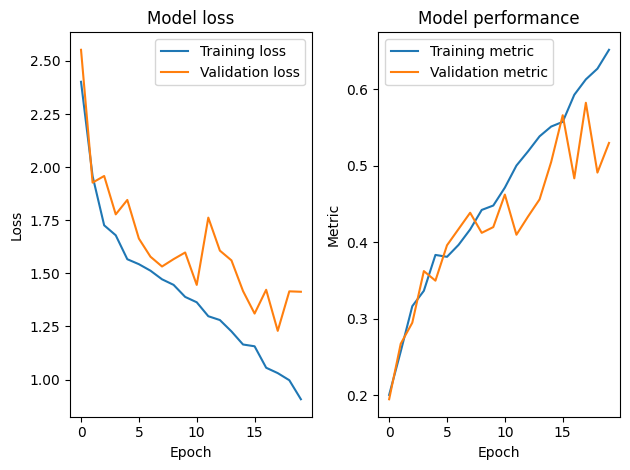

Will drop incomplete last batch for dataset ./Data/val


100%|██████████| 25/25 [00:40<00:00,  1.63s/it]


Summary statistics:
Precision: 0.5299999713897705
Recall: 0.5299999713897705
F1: 0.5299999713897705
Per class F1 score:
                       Metric value
Albrecht_Durer                 0.76
Alfred_Sisley                  0.65
Edgar_Degas                    0.57
Francisco_Goya                 0.53
Pablo_Picasso                  0.46
Paul_Gauguin                   0.65
Pierre-Auguste_Renoir          0.30
Rembrandt                      0.54
Titian                         0.42
Vincent_van_Gogh               0.44


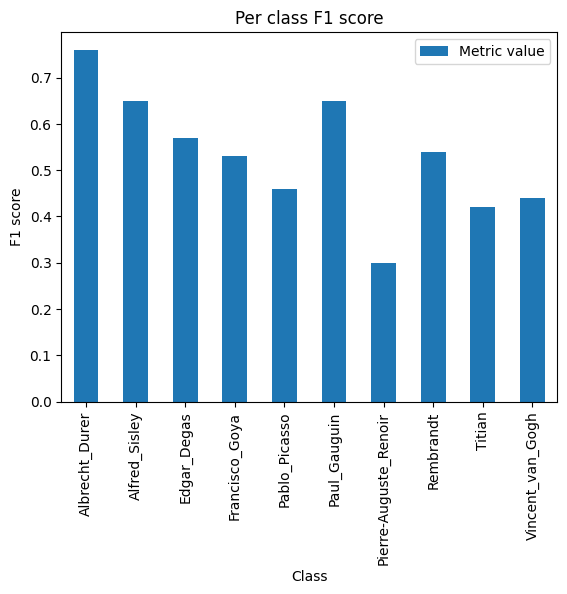

In [ ]:
resnet_3 = ResNet()
optimizer = optim.AdamW(resnet_3.parameters(), lr, weight_decay=1e-3)

train_model(resnet_3, optimizer, image_transforms, image_transforms,
            batch_size, epochs, "models/resnet_3.pt", class_weights_tensor)
test_model(resnet_3, image_transforms, batch_size)

We still get worse results than the baseline model. Let's switch gears and try a different optimizer for the original model.

Will drop incomplete last batch for dataset ./Data/train
Will drop incomplete last batch for dataset ./Data/val
Epoch [1/20]:


100%|██████████| 25/25 [00:41<00:00,  1.65s/it]


Average training loss: 1.6807460094753064
Average validation loss: 1.8367042303085328
Training metric score: 0.4103618562221527
Validation metric score: 0.4025000035762787

Epoch [2/20]:


100%|██████████| 25/25 [00:41<00:00,  1.68s/it]


Average training loss: 1.4200307664118315
Average validation loss: 1.5147151499986649
Training metric score: 0.49547696113586426
Validation metric score: 0.48750001192092896

Epoch [3/20]:


100%|██████████| 25/25 [00:44<00:00,  1.76s/it]


Average training loss: 1.2699822430547916
Average validation loss: 1.3452348971366883
Training metric score: 0.5567434430122375
Validation metric score: 0.5237500071525574

Epoch [4/20]:


100%|██████████| 25/25 [00:43<00:00,  1.74s/it]


Average training loss: 1.1594676908693815
Average validation loss: 1.2652644336223602
Training metric score: 0.5867598652839661
Validation metric score: 0.5425000190734863

Epoch [5/20]:


100%|██████████| 25/25 [00:42<00:00,  1.72s/it]


Average training loss: 1.0492000391608791
Average validation loss: 1.1998201406002045
Training metric score: 0.6373355388641357
Validation metric score: 0.6050000190734863

Epoch [6/20]:


100%|██████████| 25/25 [00:42<00:00,  1.72s/it]


Average training loss: 0.9131551824117962
Average validation loss: 1.2537573277950287
Training metric score: 0.6895559430122375
Validation metric score: 0.5674999952316284

Epoch [7/20]:


100%|██████████| 25/25 [00:46<00:00,  1.86s/it]


Average training loss: 0.823360268614794
Average validation loss: 3.951452851295471
Training metric score: 0.7220394611358643
Validation metric score: 0.4099999964237213

Epoch [8/20]:


100%|██████████| 25/25 [00:43<00:00,  1.73s/it]


Average training loss: 0.7143257491682705
Average validation loss: 1.231838047504425
Training metric score: 0.7512335777282715
Validation metric score: 0.5950000286102295

Epoch [9/20]:


100%|██████████| 25/25 [00:42<00:00,  1.71s/it]


Average training loss: 0.5331018123971788
Average validation loss: 1.3187479555606842
Training metric score: 0.8248355388641357
Validation metric score: 0.5924999713897705

Epoch [10/20]:


100%|██████████| 25/25 [00:41<00:00,  1.66s/it]


Average training loss: 0.39638399960179077
Average validation loss: 1.5092165613174437
Training metric score: 0.8795230388641357
Validation metric score: 0.574999988079071

Epoch [11/20]:


100%|██████████| 25/25 [00:41<00:00,  1.65s/it]


Average training loss: 0.23693426521985153
Average validation loss: 1.1576354503631592
Training metric score: 0.9284539222717285
Validation metric score: 0.6499999761581421

Epoch [12/20]:


100%|██████████| 25/25 [00:42<00:00,  1.69s/it]


Average training loss: 0.14856280518793746
Average validation loss: 2.1919739016890527
Training metric score: 0.9654605388641357
Validation metric score: 0.4950000047683716

Epoch [13/20]:


100%|██████████| 25/25 [00:44<00:00,  1.79s/it]


Average training loss: 0.08813081681728363
Average validation loss: 1.2581457090377808
Training metric score: 0.9847862124443054
Validation metric score: 0.6412500143051147

Epoch [14/20]:


100%|██████████| 25/25 [00:45<00:00,  1.83s/it]


Average training loss: 0.04642825083513009
Average validation loss: 1.1028284692764283
Training metric score: 0.9934210777282715
Validation metric score: 0.6712499856948853

Epoch [15/20]:


100%|██████████| 25/25 [00:41<00:00,  1.67s/it]


Average training loss: 0.036413735814245514
Average validation loss: 1.1527257573604583
Training metric score: 0.9930098652839661
Validation metric score: 0.6662499904632568

Epoch [16/20]:


100%|██████████| 25/25 [00:43<00:00,  1.73s/it]


Average training loss: 0.04393160565584702
Average validation loss: 1.223240953683853
Training metric score: 0.9925987124443054
Validation metric score: 0.6549999713897705

Epoch [17/20]:


100%|██████████| 25/25 [00:45<00:00,  1.83s/it]


Average training loss: 0.0332600670302973
Average validation loss: 1.255980796813965
Training metric score: 0.9946545958518982
Validation metric score: 0.6499999761581421

Epoch [18/20]:


100%|██████████| 25/25 [00:46<00:00,  1.86s/it]


Average training loss: 0.040017264974793715
Average validation loss: 1.65529522895813
Training metric score: 0.9930098652839661
Validation metric score: 0.5575000047683716

Epoch [19/20]:


100%|██████████| 25/25 [00:46<00:00,  1.87s/it]


Average training loss: 0.016046801551343186
Average validation loss: 1.227467086315155
Training metric score: 0.9987664222717285
Validation metric score: 0.6462500095367432

Epoch [20/20]:


100%|██████████| 25/25 [00:42<00:00,  1.72s/it]


Average training loss: 0.010574269420957487
Average validation loss: 1.3075678908824921
Training metric score: 0.9995887875556946
Validation metric score: 0.6299999952316284



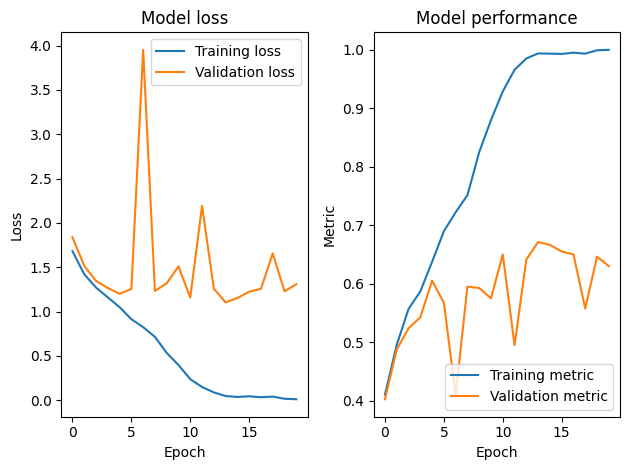

Will drop incomplete last batch for dataset ./Data/val


100%|██████████| 25/25 [00:43<00:00,  1.73s/it]


Summary statistics:
Precision: 0.6299999952316284
Recall: 0.6299999952316284
F1: 0.6299999952316284
Per class F1 score:
                       Metric value
Albrecht_Durer                 0.78
Alfred_Sisley                  0.66
Edgar_Degas                    0.67
Francisco_Goya                 0.58
Pablo_Picasso                  0.53
Paul_Gauguin                   0.67
Pierre-Auguste_Renoir          0.57
Rembrandt                      0.74
Titian                         0.43
Vincent_van_Gogh               0.60


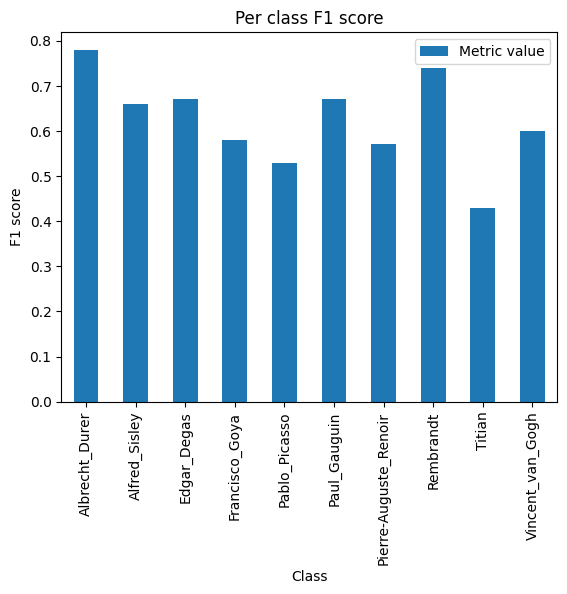

In [ ]:
resnet_4 = ResNet()
optimizer = optim.SGD(resnet_4.parameters(), lr)

train_model(resnet_4, optimizer, image_transforms, image_transforms,
            batch_size, epochs, "models/resnet_4.pt")
test_model(resnet_4, image_transforms, batch_size)

Switching to the AdamW optimizer with SGD optimizer produced the best results so far. Now let's try adding class weights again to fight the class imbalance.

Will drop incomplete last batch for dataset ./Data/train
Will drop incomplete last batch for dataset ./Data/val
Epoch [1/20]:


100%|██████████| 25/25 [00:44<00:00,  1.78s/it]


Average training loss: 1.7007468750602321
Average validation loss: 1.7818695294857025
Training metric score: 0.3622532784938812
Validation metric score: 0.3737500011920929

Epoch [2/20]:


100%|██████████| 25/25 [00:46<00:00,  1.84s/it]


Average training loss: 1.4359611068901263
Average validation loss: 1.4547627425193788
Training metric score: 0.4646381437778473
Validation metric score: 0.4937500059604645

Epoch [3/20]:


100%|██████████| 25/25 [00:46<00:00,  1.85s/it]


Average training loss: 1.2778320477197045
Average validation loss: 1.493587439060211
Training metric score: 0.5271381735801697
Validation metric score: 0.48750001192092896

Epoch [4/20]:


100%|██████████| 25/25 [00:45<00:00,  1.82s/it]


Average training loss: 1.158820047190315
Average validation loss: 1.354961324930191
Training metric score: 0.5785362124443054
Validation metric score: 0.5362499952316284

Epoch [5/20]:


100%|██████████| 25/25 [00:45<00:00,  1.81s/it]


Average training loss: 1.0595601663777703
Average validation loss: 1.498355952501297
Training metric score: 0.6081414222717285
Validation metric score: 0.4662500023841858

Epoch [6/20]:


100%|██████████| 25/25 [00:44<00:00,  1.80s/it]


Average training loss: 0.9220118146193655
Average validation loss: 1.3888873946666718
Training metric score: 0.6558387875556946
Validation metric score: 0.5199999809265137

Epoch [7/20]:


100%|██████████| 25/25 [00:45<00:00,  1.81s/it]


Average training loss: 0.8150844699458072
Average validation loss: 1.3507312834262848
Training metric score: 0.6846216917037964
Validation metric score: 0.5425000190734863

Epoch [8/20]:


100%|██████████| 25/25 [00:49<00:00,  1.96s/it]


Average training loss: 0.7013353011325786
Average validation loss: 1.4331910502910614
Training metric score: 0.734375
Validation metric score: 0.5375000238418579

Epoch [9/20]:


100%|██████████| 25/25 [00:44<00:00,  1.79s/it]


Average training loss: 0.5669909923484451
Average validation loss: 1.4266356778144837
Training metric score: 0.7763158082962036
Validation metric score: 0.5637500286102295

Epoch [10/20]:


100%|██████████| 25/25 [00:43<00:00,  1.76s/it]


Average training loss: 0.37744795629068423
Average validation loss: 1.187619503736496
Training metric score: 0.8527960777282715
Validation metric score: 0.6287500262260437

Epoch [11/20]:


100%|██████████| 25/25 [00:43<00:00,  1.76s/it]


Average training loss: 0.22979659312649778
Average validation loss: 1.1179577887058259
Training metric score: 0.9181743264198303
Validation metric score: 0.6137499809265137

Epoch [12/20]:


100%|██████████| 25/25 [00:45<00:00,  1.80s/it]


Average training loss: 0.16199284581173407
Average validation loss: 1.1763961684703828
Training metric score: 0.9444901347160339
Validation metric score: 0.6387500166893005

Epoch [13/20]:


100%|██████████| 25/25 [00:44<00:00,  1.80s/it]


Average training loss: 0.14300368861050197
Average validation loss: 1.226113387942314
Training metric score: 0.9572368264198303
Validation metric score: 0.6324999928474426

Epoch [14/20]:


100%|██████████| 25/25 [00:43<00:00,  1.74s/it]


Average training loss: 0.0804164353022842
Average validation loss: 1.1035582637786865
Training metric score: 0.9810855388641357
Validation metric score: 0.65625

Epoch [15/20]:


100%|██████████| 25/25 [00:54<00:00,  2.17s/it]


Average training loss: 0.07760044329456593
Average validation loss: 1.4057604497671128
Training metric score: 0.9728618264198303
Validation metric score: 0.5975000262260437

Epoch [16/20]:


100%|██████████| 25/25 [00:43<00:00,  1.73s/it]


Average training loss: 0.03219416032937404
Average validation loss: 1.0914812767505646
Training metric score: 0.9942434430122375
Validation metric score: 0.6700000166893005

Epoch [17/20]:


100%|██████████| 25/25 [00:42<00:00,  1.72s/it]


Average training loss: 0.01639576776467852
Average validation loss: 1.0819777631759644
Training metric score: 0.9987664222717285
Validation metric score: 0.6949999928474426

Epoch [18/20]:


100%|██████████| 25/25 [00:46<00:00,  1.86s/it]


Average training loss: 0.011387181449926606
Average validation loss: 1.1157686853408812
Training metric score: 0.9987664222717285
Validation metric score: 0.675000011920929

Epoch [19/20]:


100%|██████████| 25/25 [00:49<00:00,  1.98s/it]


Average training loss: 0.029959284672881233
Average validation loss: 1.2235758447647094
Training metric score: 0.9934210777282715
Validation metric score: 0.6512500047683716

Epoch [20/20]:


100%|██████████| 25/25 [00:46<00:00,  1.87s/it]


Average training loss: 0.032751562680411885
Average validation loss: 1.2462768363952637
Training metric score: 0.9938322305679321
Validation metric score: 0.6412500143051147



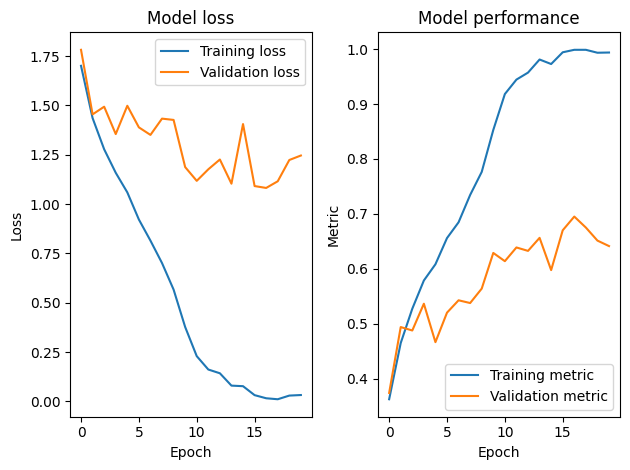

Will drop incomplete last batch for dataset ./Data/val


100%|██████████| 25/25 [00:47<00:00,  1.89s/it]


Summary statistics:
Precision: 0.6412500143051147
Recall: 0.6412500143051147
F1: 0.6412500143051147
Per class F1 score:
                       Metric value
Albrecht_Durer                 0.73
Alfred_Sisley                  0.70
Edgar_Degas                    0.65
Francisco_Goya                 0.61
Pablo_Picasso                  0.57
Paul_Gauguin                   0.71
Pierre-Auguste_Renoir          0.47
Rembrandt                      0.72
Titian                         0.71
Vincent_van_Gogh               0.63


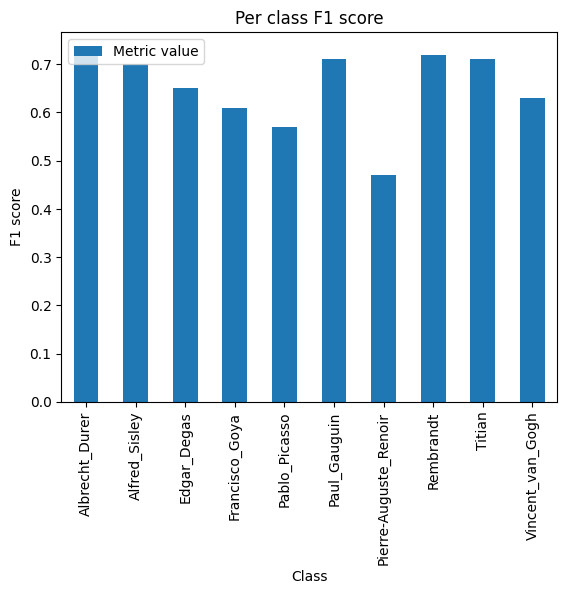

In [ ]:
resnet_5 = ResNet()
optimizer = optim.SGD(resnet_5.parameters(), lr)

train_model(resnet_5, optimizer, image_transforms, image_transforms,
            batch_size, epochs, "models/resnet_5.pt", class_weights_tensor)
test_model(resnet_5, image_transforms, batch_size)

This model achieved even better overall performance and the F1 scores are better distributed over the classes. However, the model overfit fast, so let's add some data augmentation to try to combat that.

In [31]:
augmented_transforms = transforms.Compose([
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),
    transforms.Resize((image_size, image_size)),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

Will drop incomplete last batch for dataset ./Data/train
Will drop incomplete last batch for dataset ./Data/val
Epoch [1/20]:


100%|██████████| 25/25 [00:37<00:00,  1.51s/it]


Average training loss: 2.0374839901924133
Average validation loss: 1.8190774846076965
Training metric score: 0.2927631437778473
Validation metric score: 0.35874998569488525

Epoch [2/20]:


100%|██████████| 25/25 [00:39<00:00,  1.58s/it]


Average training loss: 1.6580743350480731
Average validation loss: 1.659550859928131
Training metric score: 0.41611841320991516
Validation metric score: 0.4137499928474426

Epoch [3/20]:


100%|██████████| 25/25 [00:42<00:00,  1.68s/it]


Average training loss: 1.5417891003583606
Average validation loss: 1.6016492795944215
Training metric score: 0.4502467215061188
Validation metric score: 0.4449999928474426

Epoch [4/20]:


100%|██████████| 25/25 [00:44<00:00,  1.80s/it]


Average training loss: 1.4684864753171016
Average validation loss: 1.5228386282920838
Training metric score: 0.47039473056793213
Validation metric score: 0.45625001192092896

Epoch [5/20]:


100%|██████████| 25/25 [00:48<00:00,  1.95s/it]


Average training loss: 1.4081954383536388
Average validation loss: 1.4716432881355286
Training metric score: 0.4893092215061188
Validation metric score: 0.49000000953674316

Epoch [6/20]:


100%|██████████| 25/25 [00:48<00:00,  1.94s/it]


Average training loss: 1.3654581167195972
Average validation loss: 1.4443560934066773
Training metric score: 0.4934210479259491
Validation metric score: 0.4762499928474426

Epoch [7/20]:


100%|██████████| 25/25 [00:46<00:00,  1.86s/it]


Average training loss: 1.3164872793774856
Average validation loss: 1.4170245003700257
Training metric score: 0.5135690569877625
Validation metric score: 0.4950000047683716

Epoch [8/20]:


100%|██████████| 25/25 [00:47<00:00,  1.92s/it]


Average training loss: 1.2870534140812724
Average validation loss: 1.4335730028152467
Training metric score: 0.5320723652839661
Validation metric score: 0.48124998807907104

Epoch [9/20]:


100%|██████████| 25/25 [00:46<00:00,  1.86s/it]


Average training loss: 1.2443129733989113
Average validation loss: 1.3409714031219482
Training metric score: 0.5411184430122375
Validation metric score: 0.5375000238418579

Epoch [10/20]:


100%|██████████| 25/25 [00:47<00:00,  1.90s/it]


Average training loss: 1.2002707790387304
Average validation loss: 1.329536440372467
Training metric score: 0.5604440569877625
Validation metric score: 0.550000011920929

Epoch [11/20]:


100%|██████████| 25/25 [00:40<00:00,  1.63s/it]


Average training loss: 1.1556609884688729
Average validation loss: 1.3502905464172363
Training metric score: 0.5847039222717285
Validation metric score: 0.5337499976158142

Epoch [12/20]:


100%|██████████| 25/25 [00:39<00:00,  1.57s/it]


Average training loss: 1.1346714002521414
Average validation loss: 1.3137138831615447
Training metric score: 0.5863487124443054
Validation metric score: 0.5462499856948853

Epoch [13/20]:


100%|██████████| 25/25 [00:41<00:00,  1.65s/it]


Average training loss: 1.0989383992395902
Average validation loss: 1.248304181098938
Training metric score: 0.5953947305679321
Validation metric score: 0.5575000047683716

Epoch [14/20]:


100%|██████████| 25/25 [00:46<00:00,  1.84s/it]


Average training loss: 1.0897508177318072
Average validation loss: 1.2318760633468628
Training metric score: 0.6060855388641357
Validation metric score: 0.5637500286102295

Epoch [15/20]:


100%|██████████| 25/25 [00:47<00:00,  1.88s/it]


Average training loss: 1.0300254131618298
Average validation loss: 1.3107540965080262
Training metric score: 0.6167762875556946
Validation metric score: 0.5512499809265137

Epoch [16/20]:


100%|██████████| 25/25 [00:50<00:00,  2.04s/it]


Average training loss: 1.0191420708831989
Average validation loss: 1.2394069290161134
Training metric score: 0.6274670958518982
Validation metric score: 0.5637500286102295

Epoch [17/20]:


100%|██████████| 25/25 [00:59<00:00,  2.39s/it]


Average training loss: 0.9963794734917188
Average validation loss: 1.2125371861457825
Training metric score: 0.6361019611358643
Validation metric score: 0.5837500095367432

Epoch [18/20]:


100%|██████████| 25/25 [00:53<00:00,  2.13s/it]


Average training loss: 0.9658116306129255
Average validation loss: 1.2589762711524963
Training metric score: 0.6587170958518982
Validation metric score: 0.5550000071525574

Epoch [19/20]:


100%|██████████| 25/25 [00:51<00:00,  2.04s/it]


Average training loss: 0.9596502373093053
Average validation loss: 1.1903481817245483
Training metric score: 0.6504934430122375
Validation metric score: 0.5912500023841858

Epoch [20/20]:


100%|██████████| 25/25 [00:49<00:00,  1.99s/it]


Average training loss: 0.9175008009923132
Average validation loss: 1.212042132616043
Training metric score: 0.6726973652839661
Validation metric score: 0.5862500071525574



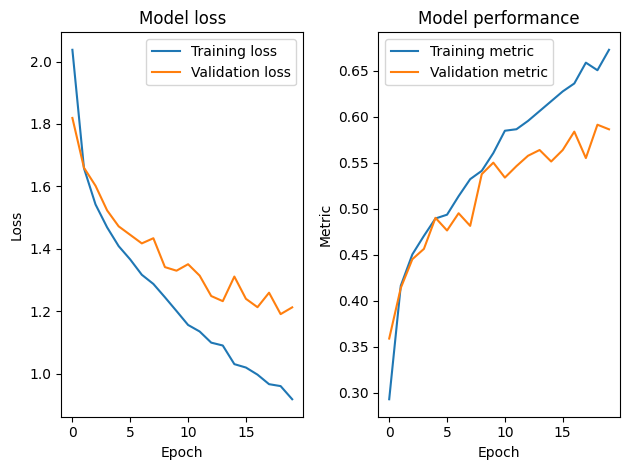

Will drop incomplete last batch for dataset ./Data/val


100%|██████████| 25/25 [00:49<00:00,  1.99s/it]


Summary statistics:
Precision: 0.5862500071525574
Recall: 0.5862500071525574
F1: 0.5862500071525574
Per class F1 score:
                       Metric value
Albrecht_Durer                 0.70
Alfred_Sisley                  0.73
Edgar_Degas                    0.59
Francisco_Goya                 0.44
Pablo_Picasso                  0.53
Paul_Gauguin                   0.64
Pierre-Auguste_Renoir          0.47
Rembrandt                      0.67
Titian                         0.51
Vincent_van_Gogh               0.56


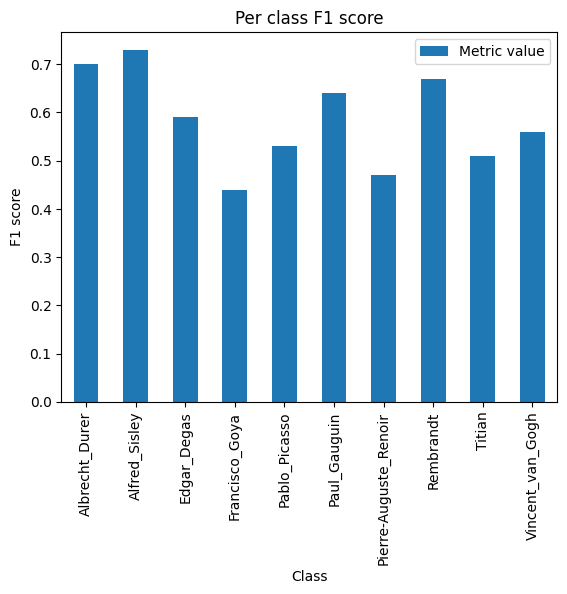

In [ ]:
resnet_6 = ResNet()
optimizer = optim.SGD(resnet_6.parameters(), lr)

train_model(resnet_6, optimizer, augmented_transforms, image_transforms,
            batch_size, epochs, "models/resnet_6.pt", class_weights_tensor)
test_model(resnet_6, image_transforms, batch_size)

The data augmentation helped with the overfitting and the validation loss looks more stable now. However, the model is learning relatively slow. So, let's add learning rate scheduling. We'll use the cosine annealing approach.

Will drop incomplete last batch for dataset ./Data/train
Will drop incomplete last batch for dataset ./Data/val
Epoch [1/20]:


100%|██████████| 25/25 [00:51<00:00,  2.08s/it]


Average training loss: 1.7261092051079399
Average validation loss: 2.247385220527649
Training metric score: 0.35485196113586426
Validation metric score: 0.32124999165534973

Epoch [2/20]:


100%|██████████| 25/25 [00:51<00:00,  2.08s/it]


Average training loss: 1.4683735935311568
Average validation loss: 1.6941721320152283
Training metric score: 0.46875
Validation metric score: 0.40625

Epoch [3/20]:


100%|██████████| 25/25 [00:50<00:00,  2.02s/it]


Average training loss: 1.309970208688786
Average validation loss: 1.7890067791938782
Training metric score: 0.5127466917037964
Validation metric score: 0.39500001072883606

Epoch [4/20]:


100%|██████████| 25/25 [00:49<00:00,  1.97s/it]


Average training loss: 1.2167851109253733
Average validation loss: 1.6821611952781677
Training metric score: 0.5592105388641357
Validation metric score: 0.4050000011920929

Epoch [5/20]:


100%|██████████| 25/25 [00:50<00:00,  2.04s/it]


Average training loss: 1.1203417801543285
Average validation loss: 1.505303785800934
Training metric score: 0.5834704041481018
Validation metric score: 0.45750001072883606

Epoch [6/20]:


100%|██████████| 25/25 [00:48<00:00,  1.95s/it]


Average training loss: 1.0321424125056518
Average validation loss: 1.4903889393806458
Training metric score: 0.6270559430122375
Validation metric score: 0.46875

Epoch [7/20]:


100%|██████████| 25/25 [00:48<00:00,  1.95s/it]


Average training loss: 0.9542944886182484
Average validation loss: 1.5117063224315643
Training metric score: 0.6455591917037964
Validation metric score: 0.48750001192092896

Epoch [8/20]:


100%|██████████| 25/25 [00:47<00:00,  1.90s/it]


Average training loss: 0.8696060039495167
Average validation loss: 1.0592985665798187
Training metric score: 0.6681743264198303
Validation metric score: 0.6237499713897705

Epoch [9/20]:


100%|██████████| 25/25 [00:49<00:00,  1.98s/it]


Average training loss: 0.774929110941134
Average validation loss: 1.0987708461284638
Training metric score: 0.7105262875556946
Validation metric score: 0.6100000143051147

Epoch [10/20]:


100%|██████████| 25/25 [00:48<00:00,  1.92s/it]


Average training loss: 0.6744460192950148
Average validation loss: 0.9937892830371857
Training metric score: 0.7356085777282715
Validation metric score: 0.6575000286102295

Epoch [11/20]:


100%|██████████| 25/25 [00:48<00:00,  1.92s/it]


Average training loss: 0.5784605392499974
Average validation loss: 0.9971431362628936
Training metric score: 0.7824835777282715
Validation metric score: 0.6524999737739563

Epoch [12/20]:


100%|██████████| 25/25 [00:55<00:00,  2.24s/it]


Average training loss: 0.5343848635491572
Average validation loss: 0.9634546518325806
Training metric score: 0.8030427694320679
Validation metric score: 0.6725000143051147

Epoch [13/20]:


100%|██████████| 25/25 [00:44<00:00,  1.79s/it]


Average training loss: 0.4345938512369206
Average validation loss: 0.9334976685047149
Training metric score: 0.8400493264198303
Validation metric score: 0.6800000071525574

Epoch [14/20]:


100%|██████████| 25/25 [00:48<00:00,  1.95s/it]


Average training loss: 0.366389966324756
Average validation loss: 0.8871617925167083
Training metric score: 0.8667762875556946
Validation metric score: 0.6899999976158142

Epoch [15/20]:


100%|██████████| 25/25 [00:48<00:00,  1.92s/it]


Average training loss: 0.31101526143519503
Average validation loss: 0.839476580619812
Training metric score: 0.9009045958518982
Validation metric score: 0.7162500023841858

Epoch [16/20]:


100%|██████████| 25/25 [00:53<00:00,  2.12s/it]


Average training loss: 0.2778527462168744
Average validation loss: 0.8094683611392974
Training metric score: 0.9120065569877625
Validation metric score: 0.7325000166893005

Epoch [17/20]:


100%|██████████| 25/25 [00:53<00:00,  2.12s/it]


Average training loss: 0.2614424221805836
Average validation loss: 0.7894616067409516
Training metric score: 0.9144737124443054
Validation metric score: 0.7250000238418579

Epoch [18/20]:


100%|██████████| 25/25 [00:56<00:00,  2.27s/it]


Average training loss: 0.23638172761390083
Average validation loss: 0.7816816937923431
Training metric score: 0.9313322305679321
Validation metric score: 0.731249988079071

Epoch [19/20]:


100%|██████████| 25/25 [00:52<00:00,  2.09s/it]


Average training loss: 0.22599979441024756
Average validation loss: 0.7870406818389892
Training metric score: 0.9375
Validation metric score: 0.7275000214576721

Epoch [20/20]:


100%|██████████| 25/25 [00:48<00:00,  1.94s/it]


Average training loss: 0.22003636940529472
Average validation loss: 0.788323484659195
Training metric score: 0.9403783082962036
Validation metric score: 0.7287499904632568



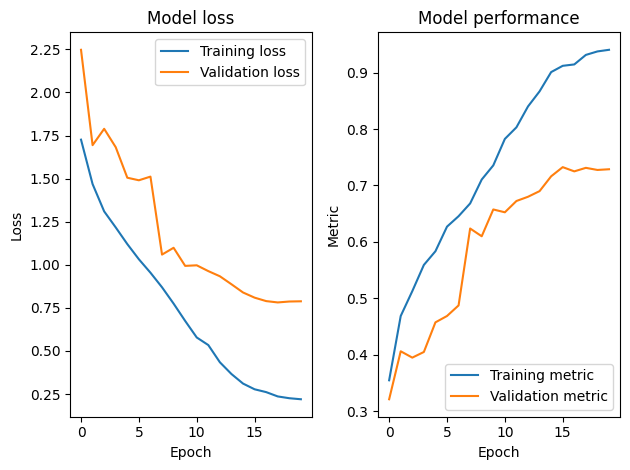

Will drop incomplete last batch for dataset ./Data/val


100%|██████████| 25/25 [00:49<00:00,  1.99s/it]



Summary statistics:
Precision: 0.7287499904632568
Recall: 0.7287499904632568
F1: 0.7287499904632568
Per class F1 score:
                       Metric value
Albrecht_Durer                 0.84
Alfred_Sisley                  0.82
Edgar_Degas                    0.77
Francisco_Goya                 0.68
Pablo_Picasso                  0.67
Paul_Gauguin                   0.73
Pierre-Auguste_Renoir          0.70
Rembrandt                      0.76
Titian                         0.70
Vincent_van_Gogh               0.67


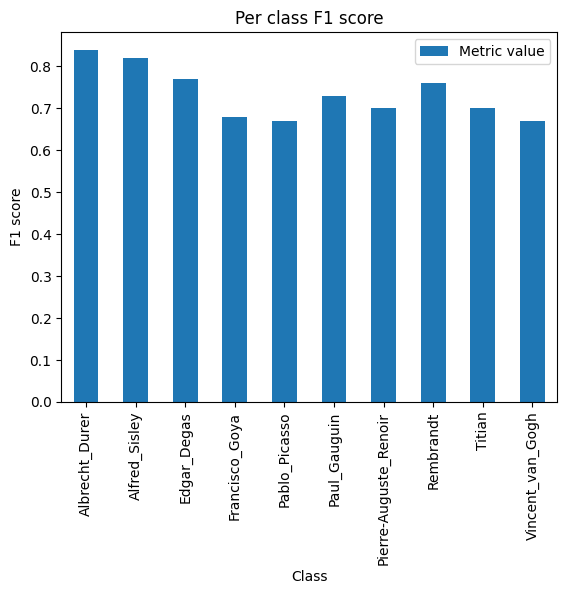

In [ ]:
resnet_7 = ResNet()
optimizer = optim.SGD(resnet_7.parameters(), lr=0.01)
scheduler = CosineAnnealingLR(optimizer, T_max=epochs, eta_min=1e-5)

train_model(resnet_7, optimizer, augmented_transforms, image_transforms,
            batch_size, epochs, "models/resnet_7.pt", class_weights_tensor,
            scheduler)
test_model(resnet_7, image_transforms, batch_size)

The cosine annealing improved the model a lot. It achieved the best overall score so far, the per-class F1 score are more similar and the validation loss is more table. Now, let's see if reducing the batch size will make any difference.

Will drop incomplete last batch for dataset ./Data/train
Will drop incomplete last batch for dataset ./Data/val
Epoch [1/20]:


100%|██████████| 50/50 [00:48<00:00,  1.04it/s]


Average training loss: 1.820839734453904
Average validation loss: 1.5972069025039672
Training metric score: 0.32195723056793213
Validation metric score: 0.44999998807907104

Epoch [2/20]:


100%|██████████| 50/50 [00:55<00:00,  1.11s/it]


Average training loss: 1.544796185666009
Average validation loss: 1.74758349776268
Training metric score: 0.4296875
Validation metric score: 0.3812499940395355

Epoch [3/20]:


100%|██████████| 50/50 [00:54<00:00,  1.09s/it]


Average training loss: 1.3850966817454289
Average validation loss: 1.471377901211381
Training metric score: 0.49917763471603394
Validation metric score: 0.4937500059604645

Epoch [4/20]:


100%|██████████| 50/50 [00:55<00:00,  1.10s/it]


Average training loss: 1.2589763120601052
Average validation loss: 1.6575821301341056
Training metric score: 0.5324835777282715
Validation metric score: 0.4749999940395355

Epoch [5/20]:


100%|██████████| 50/50 [00:50<00:00,  1.01s/it]


Average training loss: 1.1730129420757294
Average validation loss: 1.2339139088988305
Training metric score: 0.5756579041481018
Validation metric score: 0.550000011920929

Epoch [6/20]:


100%|██████████| 50/50 [00:53<00:00,  1.07s/it]


Average training loss: 1.0428200968002017
Average validation loss: 1.2860427635908127
Training metric score: 0.6085526347160339
Validation metric score: 0.5412499904632568

Epoch [7/20]:


100%|██████████| 50/50 [00:55<00:00,  1.11s/it]


Average training loss: 0.9665357062691137
Average validation loss: 1.2928013557195663
Training metric score: 0.6525493264198303
Validation metric score: 0.5512499809265137

Epoch [8/20]:


100%|██████████| 50/50 [00:53<00:00,  1.07s/it]


Average training loss: 0.8653580775778544
Average validation loss: 1.3316284680366517
Training metric score: 0.6587170958518982
Validation metric score: 0.550000011920929

Epoch [9/20]:


100%|██████████| 50/50 [00:55<00:00,  1.11s/it]


Average training loss: 0.749415067073546
Average validation loss: 1.0395958714187146
Training metric score: 0.7269737124443054
Validation metric score: 0.643750011920929

Epoch [10/20]:


100%|██████████| 50/50 [00:51<00:00,  1.04s/it]


Average training loss: 0.653601781808232
Average validation loss: 1.0471928625553846
Training metric score: 0.7479440569877625
Validation metric score: 0.6449999809265137

Epoch [11/20]:


100%|██████████| 50/50 [00:56<00:00,  1.13s/it]


Average training loss: 0.523495629821953
Average validation loss: 1.1406443509459496
Training metric score: 0.7960526347160339
Validation metric score: 0.6175000071525574

Epoch [12/20]:


100%|██████████| 50/50 [00:50<00:00,  1.01s/it]


Average training loss: 0.4202623778071843
Average validation loss: 1.056229507625103
Training metric score: 0.84375
Validation metric score: 0.6362500190734863

Epoch [13/20]:


100%|██████████| 50/50 [00:51<00:00,  1.03s/it]


Average training loss: 0.3502038259941496
Average validation loss: 1.0395328743755818
Training metric score: 0.8737664222717285
Validation metric score: 0.6549999713897705

Epoch [14/20]:


100%|██████████| 50/50 [00:48<00:00,  1.02it/s]


Average training loss: 0.2849519279981522
Average validation loss: 0.9076503464579582
Training metric score: 0.9041940569877625
Validation metric score: 0.6987500190734863

Epoch [15/20]:


100%|██████████| 50/50 [00:53<00:00,  1.07s/it]


Average training loss: 0.2208917798278363
Average validation loss: 0.9405495485663414
Training metric score: 0.9317434430122375
Validation metric score: 0.6812499761581421

Epoch [16/20]:


100%|██████████| 50/50 [00:52<00:00,  1.05s/it]


Average training loss: 0.18153867586270758
Average validation loss: 0.9207483139634133
Training metric score: 0.9518914222717285
Validation metric score: 0.7024999856948853

Epoch [17/20]:


100%|██████████| 50/50 [00:57<00:00,  1.15s/it]


Average training loss: 0.1582511470064913
Average validation loss: 0.8724022985994816
Training metric score: 0.9576480388641357
Validation metric score: 0.7137500047683716

Epoch [18/20]:


100%|██████████| 50/50 [00:54<00:00,  1.10s/it]


Average training loss: 0.14589964387644277
Average validation loss: 0.8816245523095131
Training metric score: 0.9605262875556946
Validation metric score: 0.706250011920929

Epoch [19/20]:


100%|██████████| 50/50 [00:52<00:00,  1.05s/it]


Average training loss: 0.12671656754652136
Average validation loss: 0.879162280112505
Training metric score: 0.9695723652839661
Validation metric score: 0.706250011920929

Epoch [20/20]:


100%|██████████| 50/50 [00:52<00:00,  1.05s/it]


Average training loss: 0.11990693878186376
Average validation loss: 0.8766311192512513
Training metric score: 0.9761512875556946
Validation metric score: 0.7099999785423279



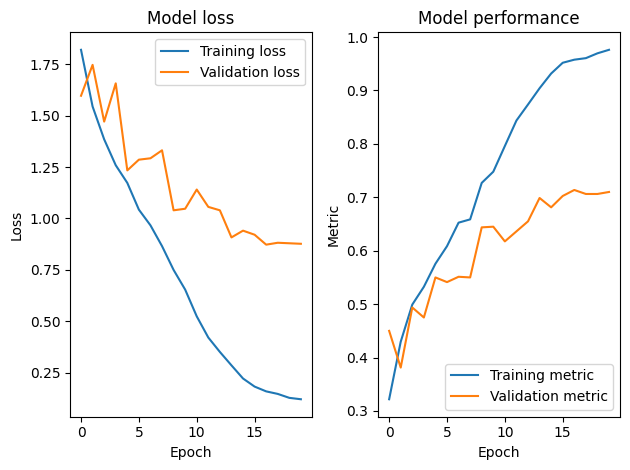

Will drop incomplete last batch for dataset ./Data/val


100%|██████████| 50/50 [00:52<00:00,  1.06s/it]


Summary statistics:
Precision: 0.7099999785423279
Recall: 0.7099999785423279
F1: 0.7099999785423279
Per class F1 score:
                       Metric value
Albrecht_Durer                 0.80
Alfred_Sisley                  0.84
Edgar_Degas                    0.75
Francisco_Goya                 0.62
Pablo_Picasso                  0.63
Paul_Gauguin                   0.74
Pierre-Auguste_Renoir          0.64
Rembrandt                      0.76
Titian                         0.67
Vincent_van_Gogh               0.68


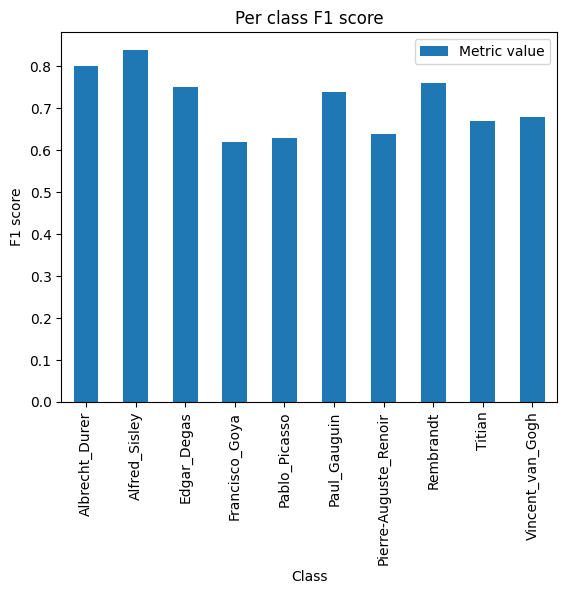

In [ ]:
batch_size = 16

resnet_8 = ResNet()
optimizer = optim.SGD(resnet_8.parameters(), lr=0.01)
scheduler = CosineAnnealingLR(optimizer, T_max=epochs, eta_min=1e-5)

train_model(resnet_8, optimizer, augmented_transforms, image_transforms,
            batch_size, epochs, "models/resnet_8.pt", class_weights_tensor,
            scheduler)
test_model(resnet_8, image_transforms, batch_size)

The lower batch size didn't lead to better results. The best results were achieved by resnet_7. For a full comparison of all the trained models, please check [the comparison table](custom_resnet_comparison.xlsx).

### 4.2. Testing the custom ResNet18 model

Now let's see how the best custom ResNet 18 model performs on the test dataset.

In [32]:
def show_confusion_matrix(preds, targets, classes):
    _, ax = plt.subplots(figsize=(10, 15))

    cm = confusion_matrix(preds, targets)

    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=classes)

    disp.plot(xticks_rotation=90, ax=ax)
    plt.title("Custom Resnet Confusion Matrix")
    plt.tight_layout()
    plt.show()

Will drop incomplete last batch for dataset ./Data/test


  0%|          | 0/25 [00:00<?, ?it/s]

100%|██████████| 25/25 [00:35<00:00,  1.42s/it]


Summary statistics:
Precision: 0.7350000143051147
Recall: 0.7350000143051147
F1: 0.7350000143051147
Per class F1 score:
                       Metric value
Albrecht_Durer                 0.86
Alfred_Sisley                  0.82
Edgar_Degas                    0.73
Francisco_Goya                 0.67
Pablo_Picasso                  0.70
Paul_Gauguin                   0.74
Pierre-Auguste_Renoir          0.64
Rembrandt                      0.73
Titian                         0.63
Vincent_van_Gogh               0.77


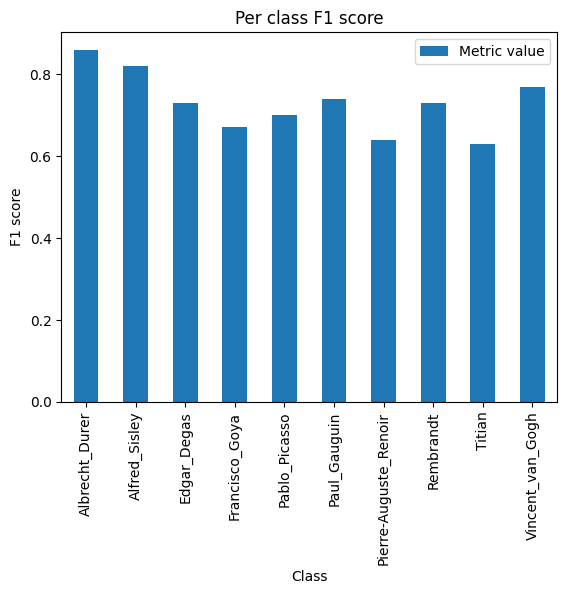

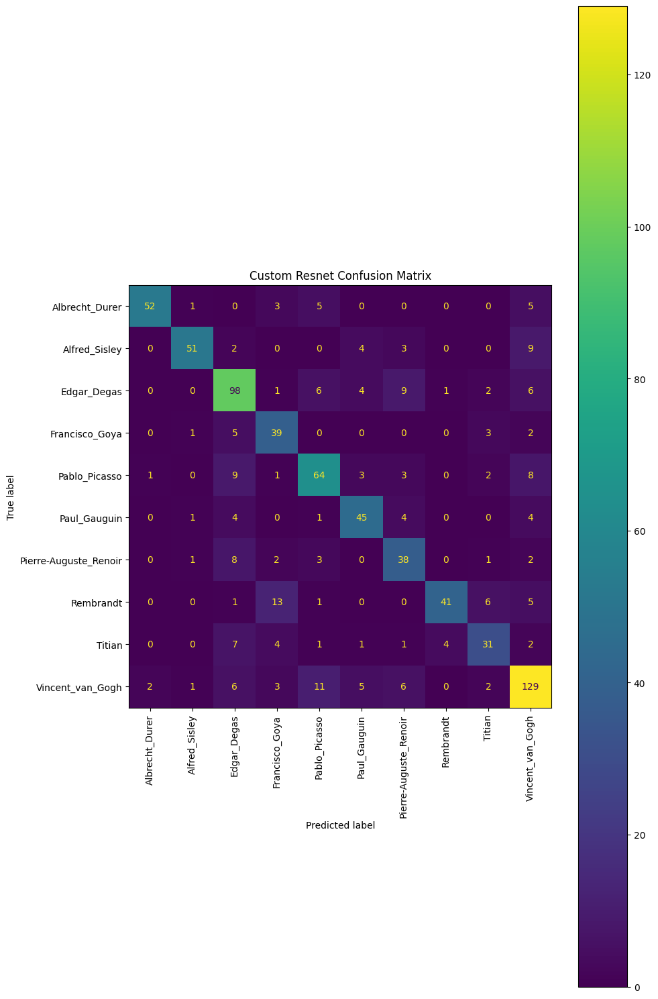

In [ ]:
preds, targets = test_model(resnet_7, image_transforms, batch_size, 'test')
show_confusion_matrix(preds, targets, datasets['test'].classes)

The model achieved an overall 0.74 F1 score on the test dataset and relatively high and balanced per-class F1 scores. The best score is for Albrecht Durer which makes sense since it's style is unique.

From the confusion matrix we can see that the model often guesses Francisco Goya when the author is Rembrandt and Pablo Picasso when it is actually Vincent van Gogh.

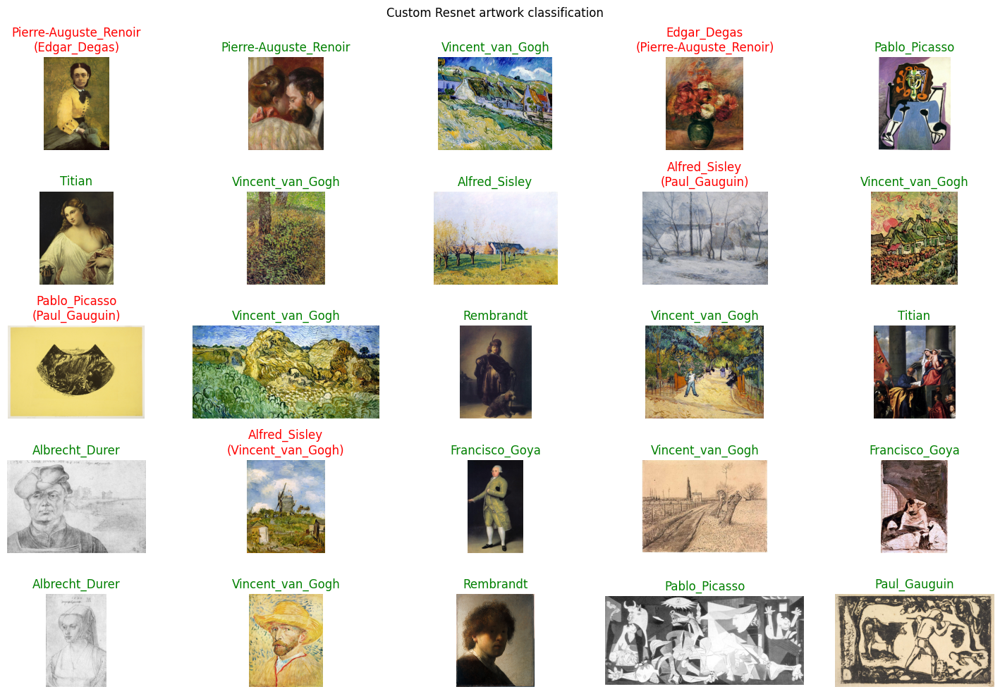

In [ ]:
test_transforms = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                            std=[0.229, 0.224, 0.225])
])

def classify(image, net):
    with torch.no_grad():
        pred = net(image).squeeze(0)

    pred_cls = pred.softmax(0)
    return pred_cls.argmax().item()


def plot_classified_images(dataloader, net):
    iterator = iter(dataloader)

    _, axs = plt.subplots(5, 5, figsize=(15, 10))
    for ax in axs.flat:
        image, label = next(iterator)

        transformed_image = torch.stack([test_transforms(image[0])])

        class_to_idx = dataloader.dataset.class_to_idx
        keys_list = list(class_to_idx.keys())
        values_list = list(class_to_idx.values())

        label = keys_list[values_list.index(label)]

        model_label = classify(transformed_image, net)
        model_label = keys_list[values_list.index(model_label)]

        image = image.squeeze().permute(1, 2, 0)

        if label != model_label:
            title = f'{model_label}\n({label})'
            color = 'red'
        else:
            title = model_label
            color = 'green'

        ax.imshow(image)
        ax.set_title(title, color=color)
        ax.axis('off')

    plt.suptitle("Custom Resnet artwork classification")
    plt.tight_layout()
    plt.show()


resnet_7.eval()

dataloader = create_dataloader(dataset_path + '/test', transforms.ToTensor(), 1, True)
plot_classified_images(dataloader, resnet_7)

## 5. Neural Style Transfer

Now. let's focus on the Neural Style Transfer task. Wel'll compare two feature extraction models - VGG19 and DeepLabV3 ResNet-101.

### 5.1. VGG19

In [34]:
vgg = vgg19(weights=VGG19_Weights.DEFAULT)
print(vgg)

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padd

We can see that the model has two parts - features and classifier. For this task we only need the features module to extract content and style information about the images.

First, we'll begin by defining modules for calculating the content and style losses. The idea is to add these modules as transparent layers after the chosen convolution (ReLU) layers whose feature maps will be used. We also need an initial layer that will normalize the input image for the underlying network since it will be changing constantly through backpropagation.

In [35]:
class Content(nn.Module):

    def __init__(self, content_features):
        super().__init__()

        self.content_features = content_features.detach()

    def forward(self, input_features):
        if self.content_features.shape[-1] == input_features.shape[-1]:
            self.loss = F.mse_loss(input_features, self.content_features)

        return input_features

    def get_loss(self):
        return self.loss


class Style(nn.Module):

    def __init__(self, style_features):
        super().__init__()

        self.style_gram_matrix = self.gram_matrix(style_features).detach()

    def forward(self, input_features):
        input_gram_matrix = self.gram_matrix(input_features)
        self.loss = torch.nn.MSELoss(reduction='sum')(input_gram_matrix,
                                                      self.style_gram_matrix)

        return input_features

    def gram_matrix(self, features):
        _, n_filters, height, width = features.size()
        resized_features = features.view(n_filters, height * width)

        result = torch.mm(resized_features, resized_features.t())
        return result.div(n_filters * height * width)

    def get_loss(self):
        return self.loss


class Normalization(nn.Module):

    def __init__(self):
        super().__init__()

        self.mean = torch.tensor([0.485, 0.456, 0.406]).view(-1, 1, 1)
        self.std = torch.tensor([0.229, 0.224, 0.225]).view(-1, 1, 1)

    def forward(self, img):
        return (img - self.mean) / self.std

Now let's create the training loop where an image (initially a copy of the content image) will be iteratively improved with gradient descent based on the content and style losses.

In [36]:
def generate(model,
             content_layer,
             style_layers,
             content_img,
             content_weight,
             style_weight,
             epochs,
             verbose=False):
    model.eval()
    model.requires_grad_(False)

    input_img = content_img.clone()
    input_img.requires_grad_(True)
    optimizer = optim.LBFGS([input_img])

    content_losses = []
    style_losses = []
    total_losses = []

    epoch = [0]
    while epoch[0] <= epochs:

        def closure():
            with torch.no_grad():
                input_img.clamp_(0, 1)

            optimizer.zero_grad()
            model(input_img)

            content_loss = content_layer.get_loss()
            content_losses.append(content_loss.item())

            style_loss = 0.0
            for sl in style_layers:
                style_loss += sl.get_loss()

            style_loss /= len(style_layers)
            style_losses.append(style_loss.item())

            total_loss = style_weight * style_loss + content_weight * content_loss
            total_losses.append(total_loss.item())

            total_loss.backward()

            epoch[0] += 1
            if verbose and epoch[0] % 50 == 0:
                print(f'Epoch {epoch[0]}/{epochs}:')
                print(
                    f'Content loss: {content_losses[-1]}; Style loss: {style_losses[-1]}; Total loss: {total_losses[-1]}'
                )
                print()

            return total_loss

        optimizer.step(closure)

    with torch.no_grad():
        input_img.clamp_(0, 1)

    return input_img, content_losses, style_losses, total_losses

Let's now create some utility functions and a function that will patch this model based on the content and style input images.

In [37]:
def plot_losses(content_losses, style_losses, total_losses):
    _, (ax1, ax2) = plt.subplots(1, 2)

    ax1.set_title("Separate losses")
    ax1.set_xlabel("Epoch")
    ax1.set_ylabel("Loss")

    x = range(len(content_losses))

    ax1.plot(x, content_losses, label='Content loss')
    ax1.plot(x, style_losses, label='Style loss')

    ax1.legend()

    ax2.set_title("Model loss")
    ax2.set_xlabel("Epoch")
    ax2.set_ylabel("Loss")

    x = range(len(total_losses))

    ax2.plot(x, total_losses)

    plt.tight_layout()
    plt.show()


def plot_images(content_img, style_img, generated_img):
    _, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 10))

    show_axis_raw_image(ax1, content_img, "Content image")
    show_axis_raw_image(ax2, style_img, "Style image")
    show_axis_image(ax3, generated_img, "Generated_image")

    plt.title("Artwork Style Transfer")

    plt.show()


def save_generated_image(image_path, generated_img):
    generated_img = generated_img.permute(
        1, 2, 0)

    if generated_img.is_floating_point():
        generated_img = generated_img.mul(255).byte().numpy()

    Image.fromarray(generated_img).save(image_path)


def transfer_style(content_filename,
                   style_filename,
                   model_builder,
                   content_feature_extractor,
                   style_feature_extractors,
                   content_weight,
                   style_weight,
                   image_height,
                   epochs,
                   verbose=False,
                   image_path=None):
    content_img = Image.open(content_filename)

    w, h = content_img.size
    aspect_ratio = w / h
    new_width = int(image_height * aspect_ratio)

    content_transforms = transforms.Compose(
        [transforms.ToTensor(),
         transforms.Resize((image_height, new_width))])
    transformed_content_img = content_transforms(content_img).unsqueeze(0)

    style_img = Image.open(style_filename)

    w, h = style_img.size
    aspect_ratio = w / h
    new_width = int(image_height * aspect_ratio)

    style_transforms = transforms.Compose(
        [transforms.ToTensor(),
         transforms.Resize((image_height, new_width))])

    transformed_style_img = style_transforms(style_img).unsqueeze(0)

    model, content_layer, style_layers = model_builder(transformed_content_img, transformed_style_img,
        content_feature_extractor, style_feature_extractors)

    generated_img, content_losses, style_losses, total_losses = generate(
        model, content_layer, style_layers, transformed_content_img,
        content_weight, style_weight, epochs, verbose)

    generated = generated_img.detach().squeeze()

    if verbose:
        plot_losses(content_losses, style_losses, total_losses)
        plot_images(content_img, style_img, generated)

    if image_path is not None:
        save_generated_image(image_path, generated)

    return generated_img, content_losses[-1], style_losses[-1], total_losses[
        -1]

In [38]:
def build_patched_vgg(content_img, style_img, content_feature_extractor,
                      style_feature_extractors):
    content_layer = None
    style_layers = []

    model = nn.Sequential(Normalization())

    vgg = vgg19(weights=VGG19_Weights.DEFAULT).features
    vgg.eval()
    vgg.requires_grad_(False)

    i = 0
    for layer in vgg.children():
        if isinstance(layer, nn.Conv2d):
            i += 1
            layer_type = 'conv'
        elif isinstance(layer, nn.ReLU):
            layer_type = 'relu'
            layer = nn.ReLU(inplace=False)
        elif isinstance(layer, nn.MaxPool2d):
            layer_type = 'max_pool'

        model.add_module(f'{layer_type}_{i}', layer)

        if layer_type == 'relu':
            if i == content_feature_extractor:
                content_features = model(content_img).detach()
                content_layer = Content(content_features)
                model.add_module(f'content_{i}', content_layer)

            if i in style_feature_extractors:
                style_features = model(style_img).detach()
                style_layers.append(Style(style_features))
                model.add_module(f'style_{i}', style_layers[-1])

    for i in range(len(model) - 1, -1, -1):
        if isinstance(model[i], Content) or isinstance(model[i], Style):
            break

    model = model[:(i + 1)]

    return model, content_layer, style_layers

Now, let's test the style transfer with different styles and parameter combinations.

In [39]:
content_weight = 1
content_feature_extractor = 10

style_weights = [10**3, 10**4, 10**5]
style_feature_extractors = [[1], [1, 3, 5], [1, 3, 5, 9, 13]]

image_height = 512
epochs = 300

In [40]:
def plot_transferred_styles(content_filename, style_filename):
    _, axes = plt.subplots(3, 3, figsize=(15, 15))

    idx = 1
    for i, row in enumerate(axes):
        for j, ax in enumerate(row):
            print(
                f'[{idx}/9] Transferring style for style_weight={style_weights[i]} and style_layers={style_feature_extractors[j]}...'
            )
            generated_img, _, _, _ = transfer_style(
                content_filename, style_filename, build_patched_vgg,
                content_feature_extractor, style_feature_extractors[j],
                content_weight, style_weights[i], image_height, epochs)

            title = f'style_layers={style_feature_extractors[j]}' if i == 0 else None
            show_axis_image(ax, generated_img.detach().squeeze(0), title, 'on')

            idx += 1

    for i, ax in enumerate(axes[:, 0]):
        row_name = f'style_weight={style_weights[i]}'
        ax.set_ylabel(row_name, rotation=0, ha='right', va='center')

    plt.tight_layout()
    plt.show()

As a content image we'll use the famous "Mona Lisa" painting by Leonardo da Vinci.

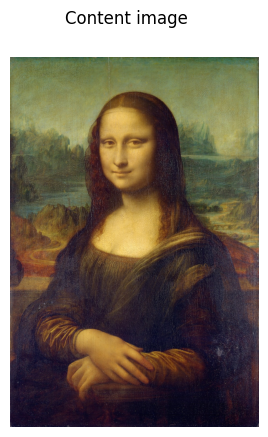

In [41]:
content_filename = "./Best_Artworks_Of_All_Time/Leonardo_da_Vinci/Leonardo_da_Vinci_121.jpg"
show_image(transforms.ToTensor()(Image.open(content_filename)), "Content image")

We'll start by transferring the style of the famous painting by Vincent van Gogh - "The Starry Night."

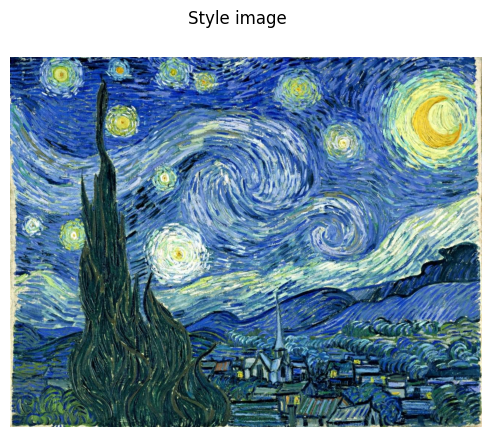

In [42]:
style_filename = "./Best_Artworks_Of_All_Time/Vincent_van_Gogh/Vincent_van_Gogh_368.jpg"
show_image(transforms.ToTensor()(Image.open(style_filename)), "Style image")

Here is an example style transfer:

Epoch 50/300:
Content loss: 7.049686431884766; Style loss: 0.054885298013687134; Total loss: 5495.57958984375

Epoch 100/300:
Content loss: 7.3294148445129395; Style loss: 0.02069760300219059; Total loss: 2077.089599609375

Epoch 150/300:
Content loss: 7.453488826751709; Style loss: 0.010870547965168953; Total loss: 1094.50830078125

Epoch 200/300:
Content loss: 7.535518169403076; Style loss: 0.00688672810792923; Total loss: 696.2083129882812

Epoch 250/300:
Content loss: 7.581040382385254; Style loss: 0.005314053036272526; Total loss: 538.986328125

Epoch 300/300:
Content loss: 7.600245952606201; Style loss: 0.004563537426292896; Total loss: 463.9539794921875



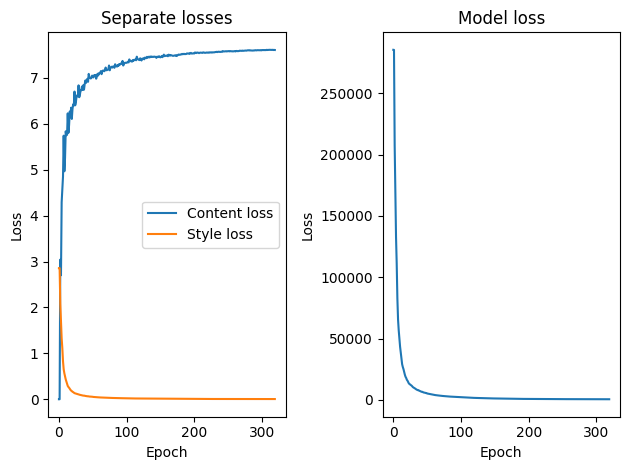

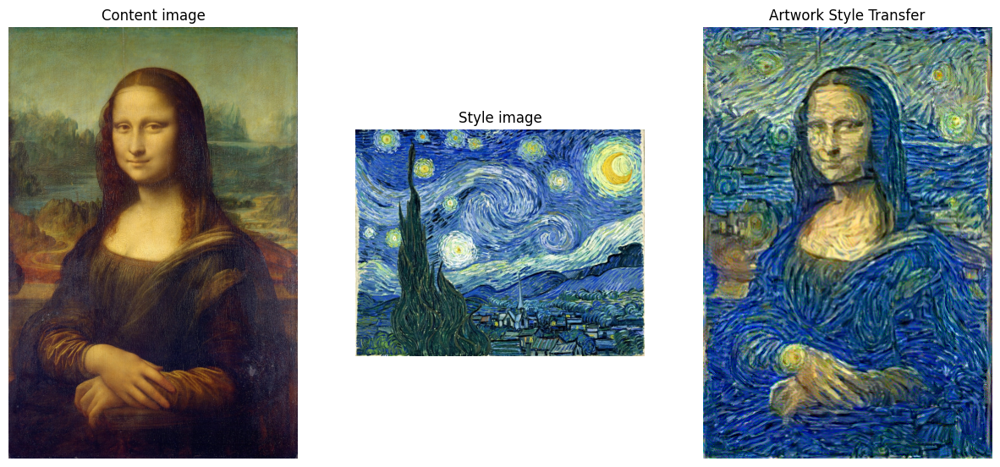

In [ ]:
transfer_style(content_filename, style_filename, build_patched_vgg, content_feature_extractor, style_feature_extractors[-1], content_weight, style_weights[-1], image_height, epochs, True)
print()

[1/9] Transferring style for style_weight=1000 and style_layers=[1]...
[2/9] Transferring style for style_weight=1000 and style_layers=[1, 3, 5]...
[3/9] Transferring style for style_weight=1000 and style_layers=[1, 3, 5, 9, 13]...
[4/9] Transferring style for style_weight=10000 and style_layers=[1]...
[5/9] Transferring style for style_weight=10000 and style_layers=[1, 3, 5]...
[6/9] Transferring style for style_weight=10000 and style_layers=[1, 3, 5, 9, 13]...
[7/9] Transferring style for style_weight=100000 and style_layers=[1]...
[8/9] Transferring style for style_weight=100000 and style_layers=[1, 3, 5]...
[9/9] Transferring style for style_weight=100000 and style_layers=[1, 3, 5, 9, 13]...


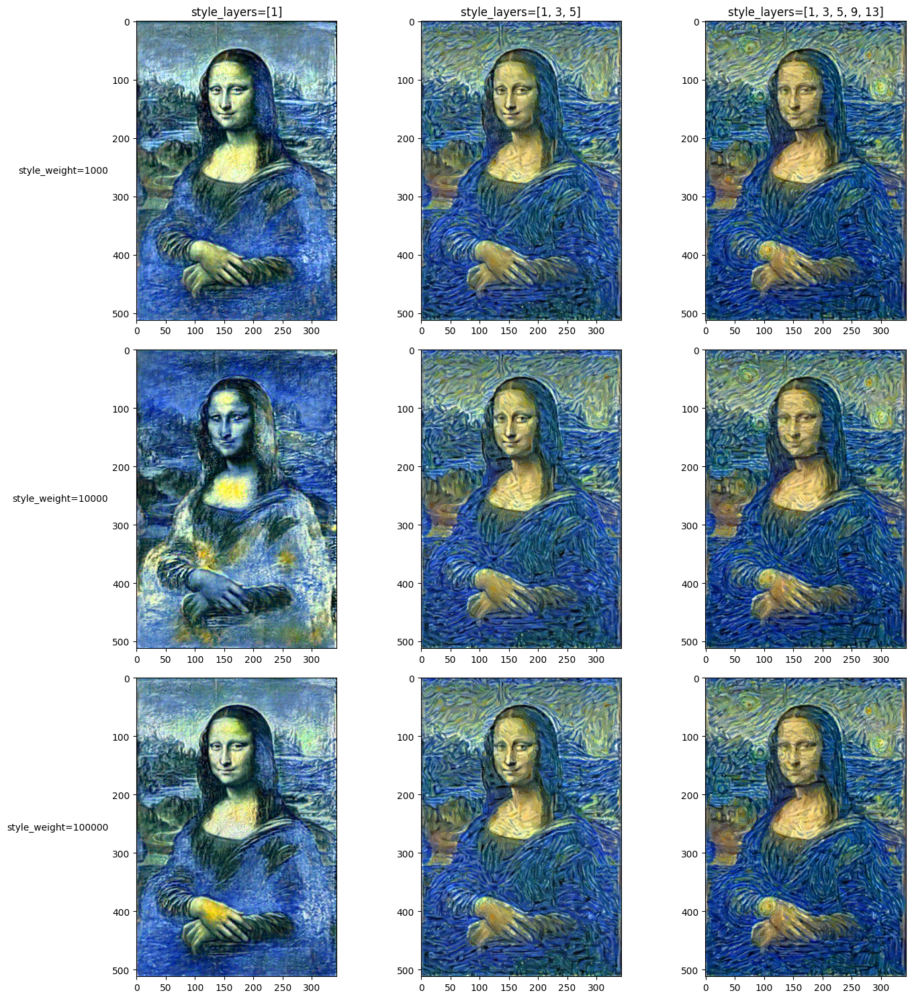

In [ ]:
plot_transferred_styles(content_filename, style_filename)

As in the original paper, for this pair of images too when using style layers up until conv5_1 we get the best performance. It seems the deeper layers capture information about the forms in the style image.

Now let's try with a style image that has more shapes and distinct objects.

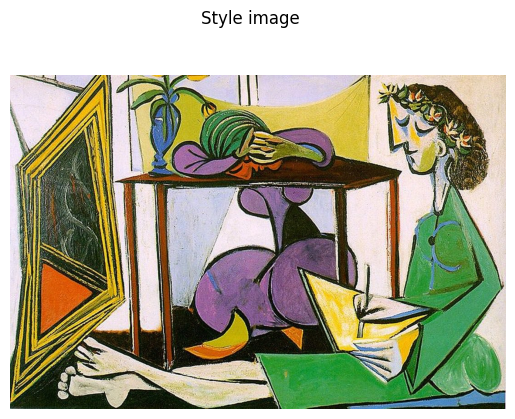

In [43]:
style_filename = "./Best_Artworks_Of_All_Time/Pablo_Picasso/Pablo_Picasso_231.jpg"
show_image(transforms.ToTensor()(Image.open(style_filename)), "Style image")

[1/9] Transferring style for style_weight=1000 and style_layers=[1]...
[2/9] Transferring style for style_weight=1000 and style_layers=[1, 3, 5]...
[3/9] Transferring style for style_weight=1000 and style_layers=[1, 3, 5, 9, 13]...
[4/9] Transferring style for style_weight=10000 and style_layers=[1]...
[5/9] Transferring style for style_weight=10000 and style_layers=[1, 3, 5]...
[6/9] Transferring style for style_weight=10000 and style_layers=[1, 3, 5, 9, 13]...
[7/9] Transferring style for style_weight=100000 and style_layers=[1]...
[8/9] Transferring style for style_weight=100000 and style_layers=[1, 3, 5]...
[9/9] Transferring style for style_weight=100000 and style_layers=[1, 3, 5, 9, 13]...


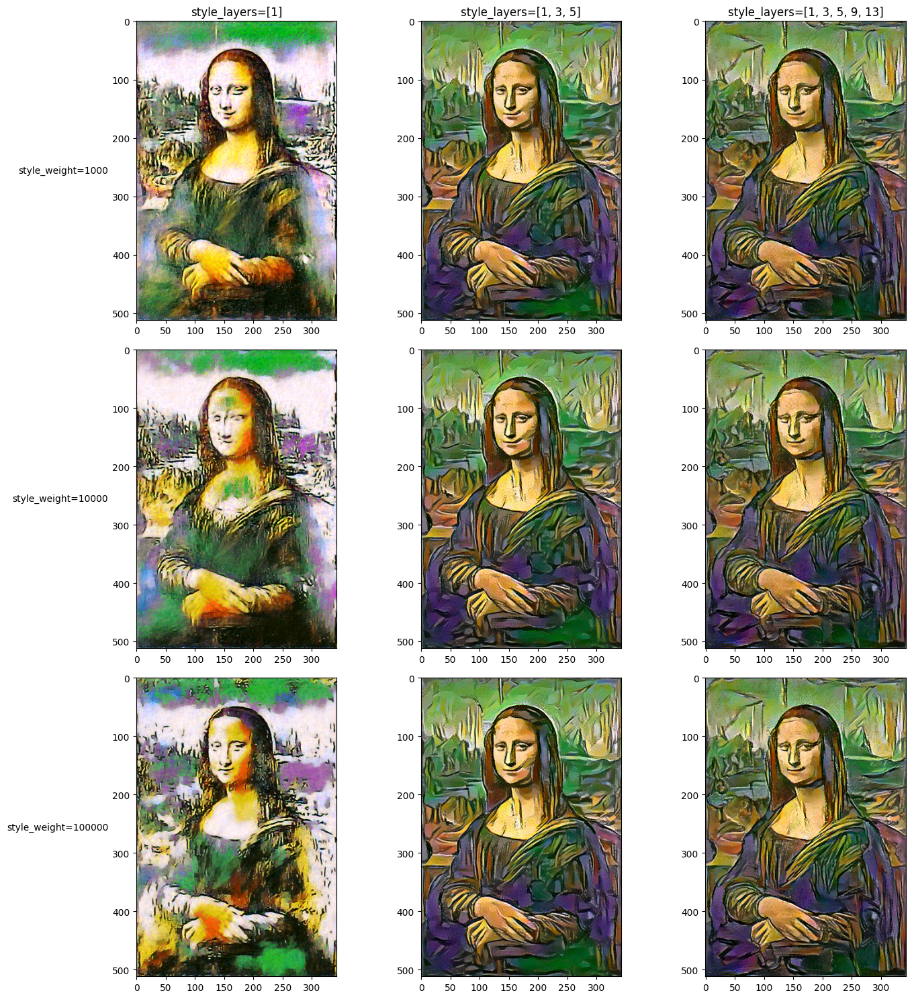

In [ ]:
plot_transferred_styles(content_filename, style_filename)

We achieved similar results here. It becomes more obvious that the initial layers don't capture enough style information, it looks like they focus mainly on the color patterns

Finally, let's test the famous "The Scream" painting since it has a very recognisable style.

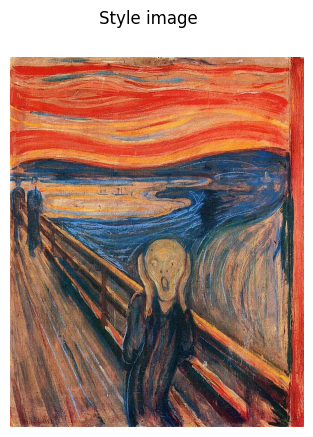

In [44]:
style_filename = "./Best_Artworks_Of_All_Time/Edvard_Munch/Edvard_Munch_12.jpg"
show_image(transforms.ToTensor()(Image.open(style_filename)), "Style image")

[1/9] Transferring style for style_weight=1000 and style_layers=[1]...
[2/9] Transferring style for style_weight=1000 and style_layers=[1, 3, 5]...
[3/9] Transferring style for style_weight=1000 and style_layers=[1, 3, 5, 9, 13]...
[4/9] Transferring style for style_weight=10000 and style_layers=[1]...
[5/9] Transferring style for style_weight=10000 and style_layers=[1, 3, 5]...
[6/9] Transferring style for style_weight=10000 and style_layers=[1, 3, 5, 9, 13]...
[7/9] Transferring style for style_weight=100000 and style_layers=[1]...
[8/9] Transferring style for style_weight=100000 and style_layers=[1, 3, 5]...
[9/9] Transferring style for style_weight=100000 and style_layers=[1, 3, 5, 9, 13]...


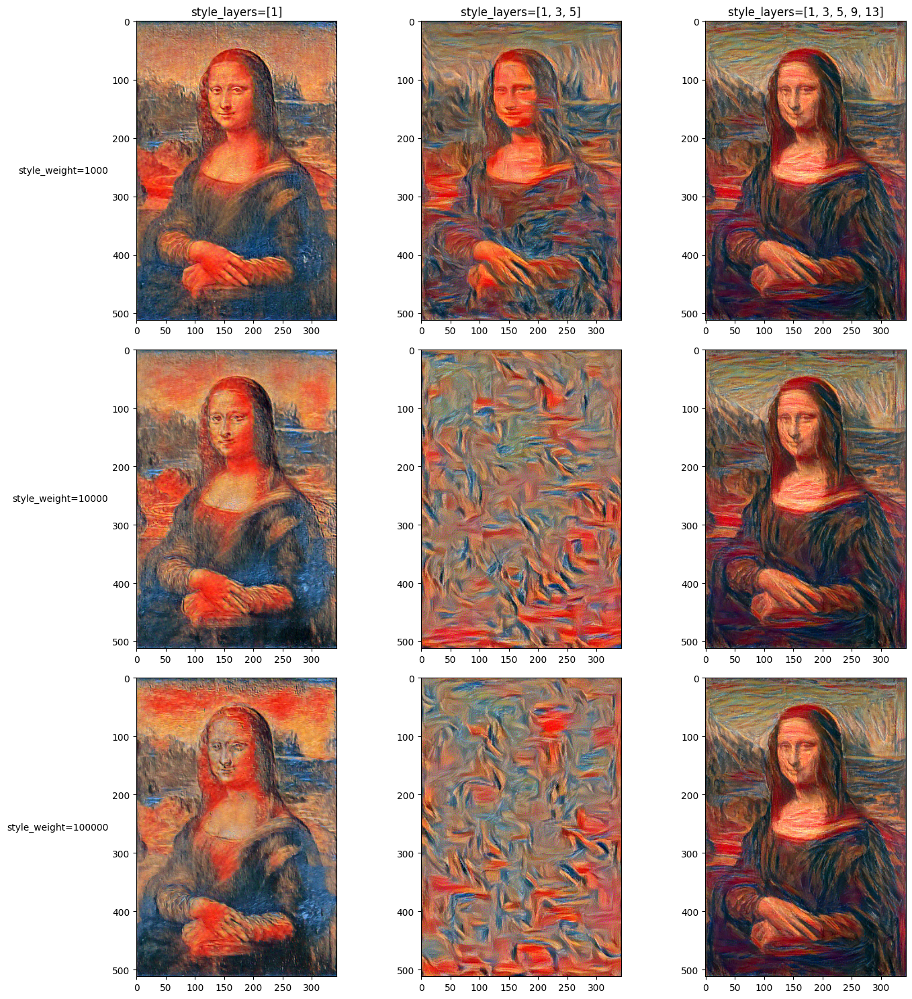

In [ ]:
plot_transferred_styles(content_filename, style_filename)

Something interesting for this style that couldn't be observed before is the worsening performance for style layers [1, 3, 5] when increasing the style weight. Adding the deeper layers seems to have solved the overpowering style issue.

### 5.2. DeepLabV3 ResNet-101

In [45]:
resnet = deeplabv3_resnet101(weights=DeepLabV3_ResNet101_Weights.DEFAULT)
print(resnet)

DeepLabV3(
  (backbone): IntermediateLayerGetter(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Se

We can see that the model has three parts - backbone, classifier and aux-classifier. Once again, we'll use only the backbone to extract the content and style information.

Now, let's define everything we'll need for the style transfer with this model.

In [54]:
imagenet_mean = [0.485, 0.456, 0.406]
imagenet_std = [0.229, 0.224, 0.225]


def get_hook(name, features):

    def hook(module, input, output):
        features[name] = output

    return hook


def get_image_tensor(img, img_height):
    w, h = img.size
    img_transforms = transforms.Compose([
        transforms.Resize((img_height, int(img_height * (w / h)))),
        transforms.ToTensor(),
        transforms.Normalize(mean=imagenet_mean, std=imagenet_std)
    ])

    return img_transforms(img).unsqueeze(0)


def gram_matrix(features):
    _, n_filters, height, width = features.size()
    resized_features = features.view(n_filters, height * width)

    result = torch.mm(resized_features, resized_features.t())
    return result.div(n_filters * height * width)


def parse_layer(layer):
    parts = layer.split('_')
    if len(parts) == 2:
        module = parts[0]
        number = int(parts[1])
    elif len(parts) == 1:
        try:
            number = int(parts[0])
            module = None
        except ValueError:
            module = parts[0]
            number = None

    return module, number


def register_hooks(model, layers):
    features = {}
    handles = []

    for name in layers:
        module, number = parse_layer(name)
        module = getattr(model, module) if module is not None else model
        module = module[number] if number is not None else module

        handle = module.register_forward_hook(get_hook(name, features))
        handles.append(handle)

    return features, handles


def get_image_features(model, layers, img_tensor):
    features, handles = register_hooks(model, layers)

    model(img_tensor)

    for handle in handles:
        handle.remove()

    return features


def normalize(img):
    imagenet_mean_tensor = torch.tensor(imagenet_mean).view(1, 3, 1, 1)
    imagenet_std_tensor = torch.tensor(imagenet_std).view(1, 3, 1, 1)

    return (img - imagenet_mean_tensor) / imagenet_std_tensor


def train(model, input_img, epochs, content_features, style_features,
          input_features, content_weight, style_weight, verbose):
    input_img.requires_grad_(True)
    optimizer = optim.LBFGS([input_img])

    content_losses = []
    style_losses = []
    total_losses = []

    epoch = [0]
    while epoch[0] < epochs:

        def closure():
            with torch.no_grad():
                input_img.clamp_(0, 1)

            normalized_input = normalize(input_img)

            optimizer.zero_grad()
            model(normalized_input)

            content_loss = 0.0
            for layer, f in content_features.items():
                content_loss += torch.nn.MSELoss()(input_features[layer], f)

            content_losses.append(content_loss.item())

            style_loss = 0.0
            for layer, f in style_features.items():
                style_loss += torch.nn.MSELoss(reduction='sum')(gram_matrix(
                    input_features[layer]), f)

            style_loss /= len(style_features)
            style_losses.append(style_loss.item())

            total_loss = style_weight * style_loss + content_weight * content_loss
            total_losses.append(total_loss.item())

            total_loss.backward()

            epoch[0] += 1
            if verbose and epoch[0] % 20 == 0:
                print(f'Epoch {epoch[0]}/{epochs}:')
                print(
                    f'Content loss: {content_losses[-1]}; Style loss: {style_losses[-1]}; Total loss: {total_losses[-1]}'
                )
                print()

            return total_loss

        optimizer.step(closure)

    with torch.no_grad():
        input_img.clamp_(0, 1)

    return input_img, content_losses, style_losses, total_losses


def transfer_style_resnet(content_filename,
                          style_filename,
                          content_layers,
                          style_layers,
                          content_weight,
                          style_weight,
                          image_height,
                          epochs,
                          verbose=False):

    model = deeplabv3_resnet101(DeepLabV3_ResNet101_Weights.DEFAULT).backbone
    model.eval()
    model.requires_grad_(False)

    content_img = Image.open(content_filename)
    content_tensor = get_image_tensor(content_img, image_height)
    content_features = get_image_features(model, content_layers,
                                          content_tensor)

    style_img = Image.open(style_filename)
    style_tensor = get_image_tensor(style_img, image_height)
    style_features = get_image_features(model, style_layers, style_tensor)

    for layer in style_features:
        style_features[layer] = gram_matrix(style_features[layer])

    input_layers = content_layers + style_layers
    input_features, _ = register_hooks(model, input_layers)

    content_transform = transforms.Compose([
        transforms.Resize((content_tensor.shape[2], content_tensor.shape[3])),
        transforms.ToTensor()
    ])

    input_img = content_transform(content_img).unsqueeze(0).clone()

    input_img, content_losses, style_losses, total_losses =  train(model, input_img, epochs, content_features, style_features,
                 input_features, content_weight, style_weight, verbose)

    if verbose:
        plot_losses(content_losses, style_losses, total_losses)
        plot_images(content_img, style_img, input_img.detach().squeeze(0))

    return input_img, content_losses, style_losses, total_losses

Now let's perform the same tests as for VGG19. The only difference will be in the layer choice.

In [46]:
image_height = 512
epochs = 100

content_weight = 1
content_layers = ['layer4']

style_weights = [10**3, 10**4, 10**5]
style_layers = [['relu', 'layer1_1', 'layer2_1', 'layer2_3', 'layer3_1'],
                ['relu', 'layer1_0', 'layer2_0', 'layer3_0', 'layer4_0'],
                ['relu', 'layer1_1', 'layer2_1', 'layer3_1', 'layer4_1']]

In [55]:
def plot_transferred_styles_resnet(content_filename, style_filename):
    _, axes = plt.subplots(len(style_weights),
                           len(style_layers),
                           figsize=(15, 15))

    idx = 1
    for i, row in enumerate(axes):
        for j, ax in enumerate(row):
            print(
                f'[{idx}/{len(style_weights) * len(style_layers)}] Transferring style for style_weight={style_weights[i]} and style_layers={style_layers[j]}...'
            )
            generated_img, _, _, _ = transfer_style_resnet(
                content_filename, style_filename, content_layers,
                style_layers[j], content_weight, style_weights[i],
                image_height, epochs)

            title = f'style_layers={style_layers[j]}' if i == 0 else None
            show_axis_image(ax, generated_img.detach().squeeze(0), title, 'on')

            idx += 1

    for i, ax in enumerate(axes[:, 0]):
        row_name = f'style_weight={style_weights[i]}'
        ax.set_ylabel(row_name, rotation=0, ha='right', va='center')

    plt.tight_layout()
    plt.show()

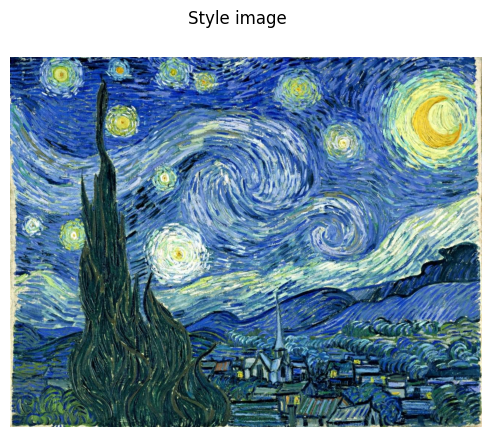

In [56]:
style_filename = "./Best_Artworks_Of_All_Time/Vincent_van_Gogh/Vincent_van_Gogh_368.jpg"
show_image(transforms.ToTensor()(Image.open(style_filename)), "Style image")

[1/9] Transferring style for style_weight=1000 and style_layers=['relu', 'layer1_1', 'layer2_1', 'layer2_3', 'layer3_1']...


/Users/veronikapopova/Documents/Uni/Master/Year_1/Sem_2/DL/venv/lib/python3.13/site-packages/torchvision/models/_utils.py:135: UserWarning: Using 'weights' as positional parameter(s) is deprecated since 0.13 and may be removed in the future. Please use keyword parameter(s) instead.
  warnings.warn(


[2/9] Transferring style for style_weight=1000 and style_layers=['relu', 'layer1_0', 'layer2_0', 'layer3_0', 'layer4_0']...
[3/9] Transferring style for style_weight=1000 and style_layers=['relu', 'layer1_1', 'layer2_1', 'layer3_1', 'layer4_1']...
[4/9] Transferring style for style_weight=10000 and style_layers=['relu', 'layer1_1', 'layer2_1', 'layer2_3', 'layer3_1']...
[5/9] Transferring style for style_weight=10000 and style_layers=['relu', 'layer1_0', 'layer2_0', 'layer3_0', 'layer4_0']...
[6/9] Transferring style for style_weight=10000 and style_layers=['relu', 'layer1_1', 'layer2_1', 'layer3_1', 'layer4_1']...
[7/9] Transferring style for style_weight=100000 and style_layers=['relu', 'layer1_1', 'layer2_1', 'layer2_3', 'layer3_1']...
[8/9] Transferring style for style_weight=100000 and style_layers=['relu', 'layer1_0', 'layer2_0', 'layer3_0', 'layer4_0']...
[9/9] Transferring style for style_weight=100000 and style_layers=['relu', 'layer1_1', 'layer2_1', 'layer3_1', 'layer4_1']...

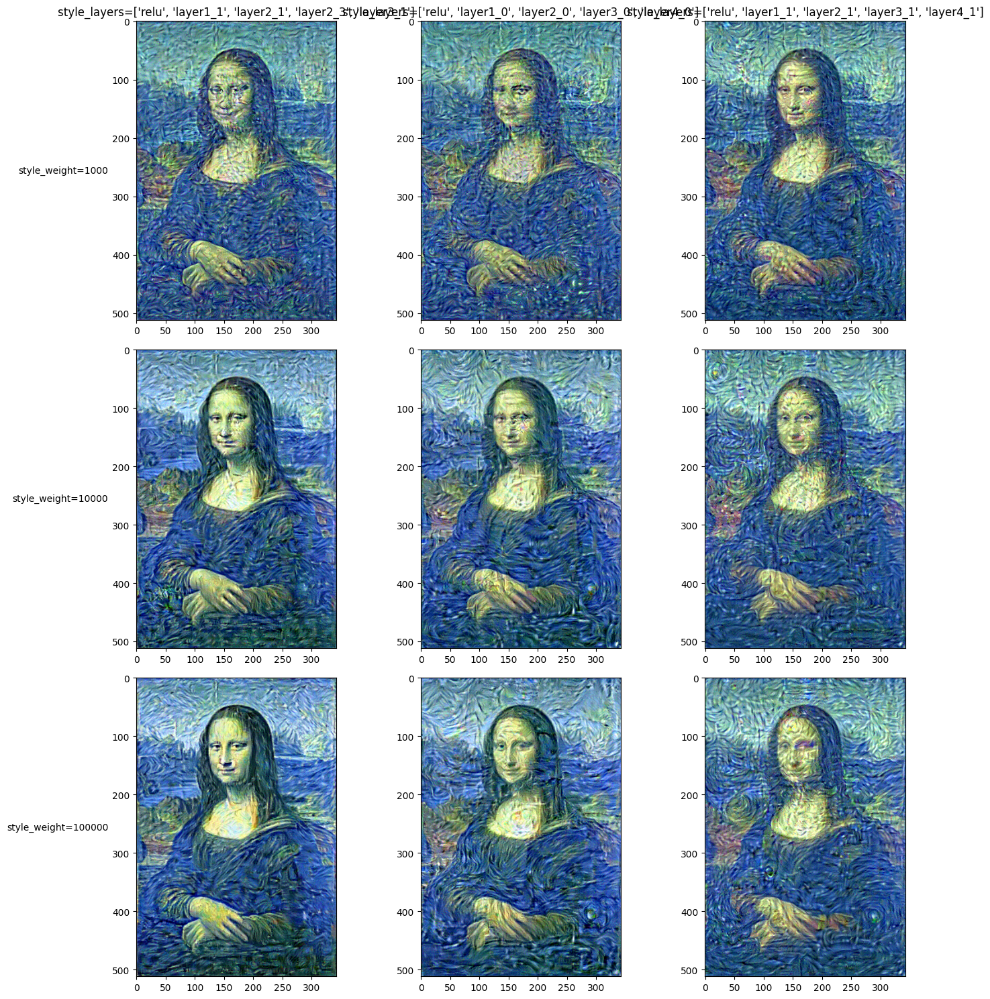

In [20]:
plot_transferred_styles_resnet(content_filename, style_filename)

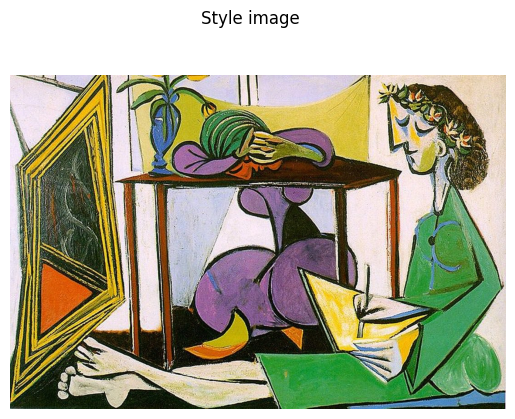

In [57]:
style_filename = "./Best_Artworks_Of_All_Time/Pablo_Picasso/Pablo_Picasso_231.jpg"
show_image(transforms.ToTensor()(Image.open(style_filename)), "Style image")

[1/9] Transferring style for style_weight=1000 and style_layers=['relu', 'layer1_1', 'layer2_1', 'layer2_3', 'layer3_1']...
[2/9] Transferring style for style_weight=1000 and style_layers=['relu', 'layer1_0', 'layer2_0', 'layer3_0', 'layer4_0']...
[3/9] Transferring style for style_weight=1000 and style_layers=['relu', 'layer1_1', 'layer2_1', 'layer3_1', 'layer4_1']...
[4/9] Transferring style for style_weight=10000 and style_layers=['relu', 'layer1_1', 'layer2_1', 'layer2_3', 'layer3_1']...
[5/9] Transferring style for style_weight=10000 and style_layers=['relu', 'layer1_0', 'layer2_0', 'layer3_0', 'layer4_0']...
[6/9] Transferring style for style_weight=10000 and style_layers=['relu', 'layer1_1', 'layer2_1', 'layer3_1', 'layer4_1']...
[7/9] Transferring style for style_weight=100000 and style_layers=['relu', 'layer1_1', 'layer2_1', 'layer2_3', 'layer3_1']...
[8/9] Transferring style for style_weight=100000 and style_layers=['relu', 'layer1_0', 'layer2_0', 'layer3_0', 'layer4_0']...
[

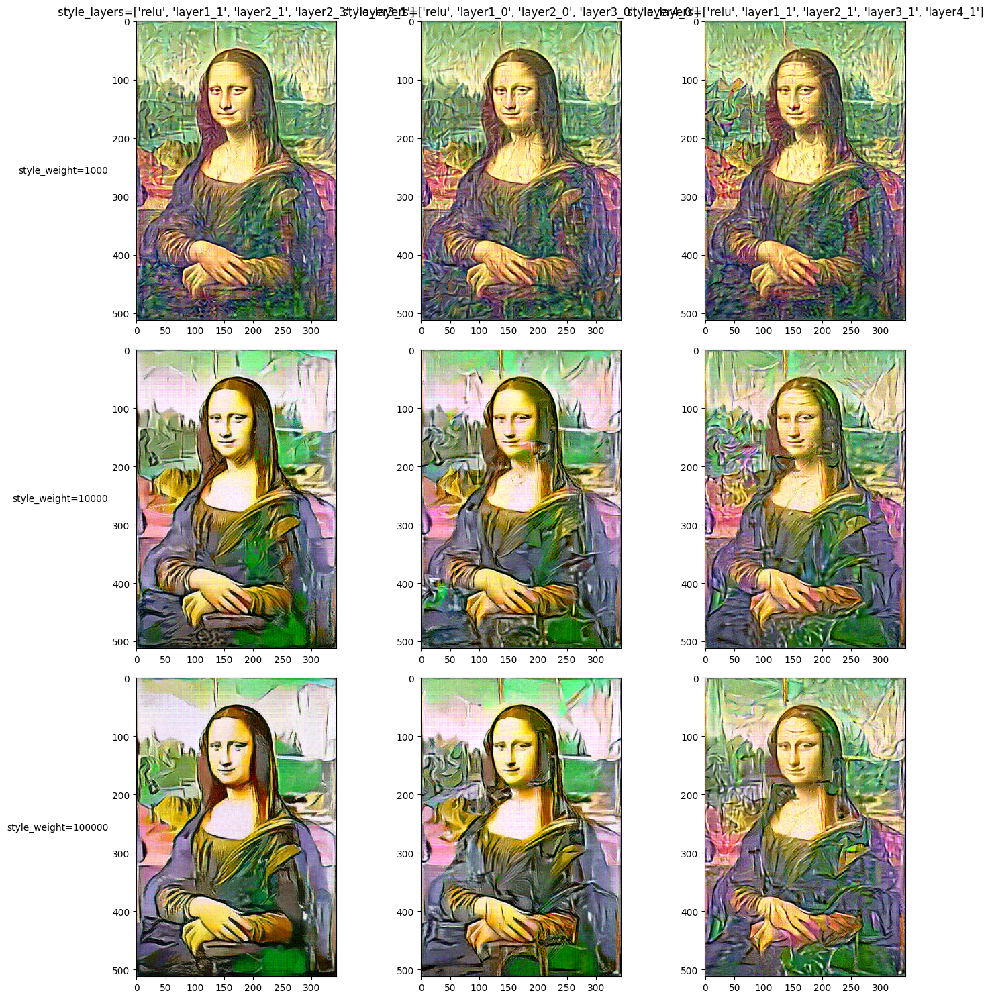

In [22]:
plot_transferred_styles_resnet(content_filename, style_filename)

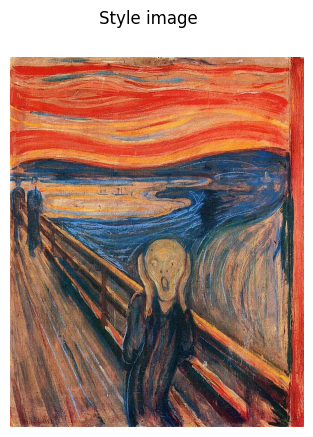

In [58]:
style_filename = "./Best_Artworks_Of_All_Time/Edvard_Munch/Edvard_Munch_12.jpg"
show_image(transforms.ToTensor()(Image.open(style_filename)), "Style image")

[1/9] Transferring style for style_weight=1000 and style_layers=['relu', 'layer1_1', 'layer2_1', 'layer2_3', 'layer3_1']...


/Users/veronikapopova/Documents/Uni/Master/Year_1/Sem_2/DL/venv/lib/python3.13/site-packages/torchvision/models/_utils.py:135: UserWarning: Using 'weights' as positional parameter(s) is deprecated since 0.13 and may be removed in the future. Please use keyword parameter(s) instead.
  warnings.warn(


[2/9] Transferring style for style_weight=1000 and style_layers=['relu', 'layer1_0', 'layer2_0', 'layer3_0', 'layer4_0']...
[3/9] Transferring style for style_weight=1000 and style_layers=['relu', 'layer1_1', 'layer2_1', 'layer3_1', 'layer4_1']...
[4/9] Transferring style for style_weight=10000 and style_layers=['relu', 'layer1_1', 'layer2_1', 'layer2_3', 'layer3_1']...
[5/9] Transferring style for style_weight=10000 and style_layers=['relu', 'layer1_0', 'layer2_0', 'layer3_0', 'layer4_0']...
[6/9] Transferring style for style_weight=10000 and style_layers=['relu', 'layer1_1', 'layer2_1', 'layer3_1', 'layer4_1']...
[7/9] Transferring style for style_weight=100000 and style_layers=['relu', 'layer1_1', 'layer2_1', 'layer2_3', 'layer3_1']...
[8/9] Transferring style for style_weight=100000 and style_layers=['relu', 'layer1_0', 'layer2_0', 'layer3_0', 'layer4_0']...
[9/9] Transferring style for style_weight=100000 and style_layers=['relu', 'layer1_1', 'layer2_1', 'layer3_1', 'layer4_1']...

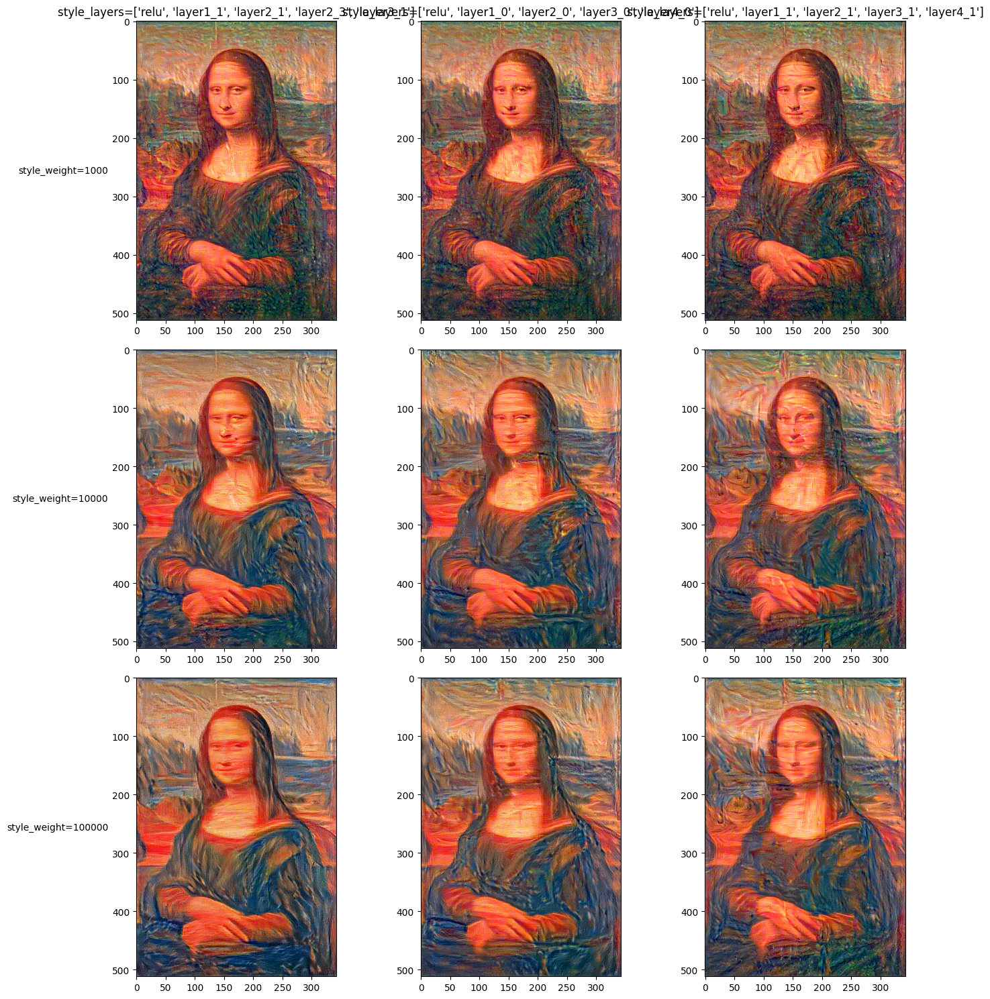

In [24]:
plot_transferred_styles_resnet(content_filename, style_filename)

### 5.3. Model comparison

Now, let's compare how both models perform for tme same content and style images. For each model we'll use the hyperparameters that gave the best results for all tested styles.

In [59]:
content_weight = 1
image_height = 512

vgg_content_layer = 10
vgg_style_layers = [1, 3, 5, 9, 13]
vgg_style_weights = 10**5
vgg_epochs = 300

resnet_content_layers = ['layer4']
resnet_style_layers = ['relu', 'layer1_1', 'layer2_1', 'layer2_3', 'layer3_1']
resnet_style_weight = 10**6
resnet_epochs = 100

In [60]:
def compare_models(content_filename, style_filenames):
    _, axes = plt.subplots(len(style_filenames), 2, figsize=(15, 15))

    for i in range(len(axes)):
        generated_img, _, _, _ = transfer_style(
            content_filename, style_filenames[i], build_patched_vgg,
            vgg_content_layer, vgg_style_layers, content_weight,
            vgg_style_weights, image_height, vgg_epochs)

        title = f'VGG' if i == 0 else None
        show_axis_image(axes[i][0], generated_img.detach().squeeze(0), title)

        generated_img, _, _, _ = transfer_style_resnet(
            content_filename, style_filenames[i], resnet_content_layers,
            resnet_style_layers, content_weight, resnet_style_weight,
            image_height, resnet_epochs)

        title = f'DeepLabV3 Resnet' if i == 0 else None
        show_axis_image(axes[i][1], generated_img.detach().squeeze(0), title)

    plt.tight_layout()
    plt.show()

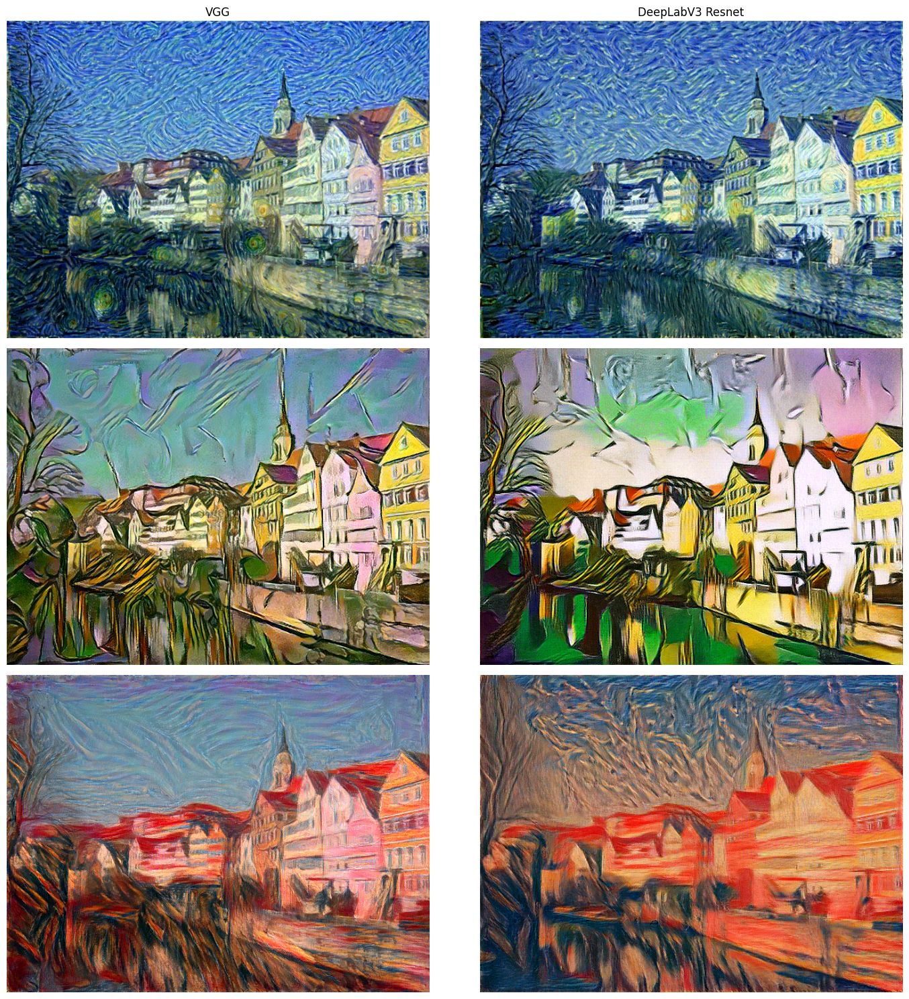

In [62]:
content_filename = "./Test/Tuebingen_Neckarfront.jpg"
style_filenames = [
    "./Best_Artworks_Of_All_Time/Vincent_van_Gogh/Vincent_van_Gogh_368.jpg",
    "./Best_Artworks_Of_All_Time/Pablo_Picasso/Pablo_Picasso_231.jpg",
    "./Best_Artworks_Of_All_Time/Edvard_Munch/Edvard_Munch_12.jpg"
]

compare_models(content_filename, style_filenames)

## 6. Try it yourself

The project includes a Streamlit app where you can try the best author classification model as well as NST with both feature extractors and configurable hyperparameters. All you need to do to launch it is run:

```bash
pip install streamlit

streamlit run ./streamlit/🏠_Home.py
```

## 7. References

[1] https://www.kaggle.com/datasets/ikarus777/best-artworks-of-all-time

[2] https://arxiv.org/pdf/1512.03385

[3] https://www.digitalocean.com/community/tutorials/writing-resnet-from-scratch-in-pytorch

[4] https://discuss.pytorch.org/t/dealing-with-imbalanced-datasets-in-pytorch/22596/1

[5] https://medium.com/@utkrisht14/cosine-learning-rate-schedulers-in-pytorch-486d8717d541

[6] https://arxiv.org/abs/1508.06576

[7] https://docs.pytorch.org/tutorials/advanced/neural_style_tutorial.html

[8] https://www.digitalocean.com/community/tutorials/pytorch-hooks-gradient-clipping-debugging

[9] https://docs.streamlit.io/